In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

In [2]:
df=pd.read_excel("World_development_mesurement (1).xlsx")

In [3]:
df.head()

,Birth Rate,Business Tax Rate,CO2 Emissions,Country,Days to Start Business,Ease of Business,Energy Usage,GDP,Health Exp % GDP,Health Exp/Capita,...,Life Expectancy Male,Mobile Phone Usage,Number of Records,Population 0-14,Population 15-64,Population 65+,Population Total,Population Urban,Tourism Inbound,Tourism Outbound
0,0.020,NaN,87931.0,Algeria,NaN,NaN,26998.0,"$54,790,058,957",0.035,$60,...,67.0,0.0,1,0.342,0.619,0.039,31719449,0.599,"$102,000,000","$193,000,000"
1,0.050,NaN,9542.0,Angola,NaN,NaN,7499.0,"$9,129,594,819",0.034,$22,...,44.0,0.0,1,0.476,0.499,0.025,13924930,0.324,"$34,000,000","$146,000,000"
2,0.043,NaN,1617.0,Benin,NaN,NaN,1983.0,"$2,359,122,303",0.043,$15,...,53.0,0.0,1,0.454,0.517,0.029,6949366,0.383,"$77,000,000","$50,000,000"
3,0.027,NaN,4276.0,Botswana,NaN,NaN,1836.0,"$5,788,311,645",0.047,$152,...,49.0,0.1,1,0.383,0.587,0.029,1755375,0.532,"$227,000,000","$209,000,000"
4,0.046,NaN,1041.0,Burkina Faso,NaN,NaN,NaN,"$2,610,959,139",0.051,$12,...,49.0,0.0,1,0.468,0.505,0.028,11607944,0.178,"$23,000,000","$30,000,000"


In [4]:
df.tail()

,Birth Rate,Business Tax Rate,CO2 Emissions,Country,Days to Start Business,Ease of Business,Energy Usage,GDP,Health Exp % GDP,Health Exp/Capita,...,Life Expectancy Male,Mobile Phone Usage,Number of Records,Population 0-14,Population 15-64,Population 65+,Population Total,Population Urban,Tourism Inbound,Tourism Outbound
2699,NaN,NaN,NaN,Turks and Caicos Islands,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,1,NaN,NaN,NaN,32427,0.911,NaN,NaN
2700,0.013,46.4%,NaN,United States,5.0,4.0,2132446.0,"$16,244,600,000,000",0.179,"$8,895",...,76.0,1.0,1,0.196,0.667,0.136,313873685,0.811,"$200,092,000,000","$126,573,000,000"
2701,0.015,41.9%,NaN,Uruguay,7.0,85.0,NaN,"$50,004,354,667",0.089,"$1,308",...,74.0,1.5,1,0.220,0.639,0.140,3395253,0.948,"$2,222,000,000","$1,028,000,000"
2702,0.020,61.9%,NaN,"Venezuela, RB",144.0,180.0,NaN,"$381,286,223,859",0.046,$593,...,72.0,1.0,1,0.288,0.652,0.060,29954782,0.889,"$904,000,000","$3,202,000,000"
2703,0.011,NaN,NaN,Virgin Islands (U.S.),NaN,NaN,NaN,NaN,NaN,NaN,...,76.0,NaN,1,0.206,0.641,0.152,105275,0.949,NaN,NaN


In [5]:
## Removing $,%,
df['GDP']=df['GDP'].astype(str).str.replace('$','',regex=True).str.replace(',','')
df['GDP']=pd.to_numeric(df['GDP'],errors='coerce')

df['Health Exp/Capita']=df['Health Exp/Capita'].astype(str).str.replace('$','',regex=True)
df['Health Exp/Capita']=pd.to_numeric(df['Health Exp/Capita'], errors='coerce')

df['Tourism Inbound']=df['Tourism Inbound'].astype(str).str.replace('$','',regex=True).str.replace(',', '')
df['Tourism Inbound'] =pd.to_numeric(df['Tourism Inbound'], errors='coerce')

df['Tourism Outbound']=df['Tourism Outbound'].astype(str).str.replace('$','',regex=True).str.replace(',', '')
df['Tourism Outbound'] = pd.to_numeric(df['Tourism Outbound'], errors='coerce')

df['Business Tax Rate']=df['Business Tax Rate'].astype(str).str.replace('%','',regex=True)
df['Business Tax Rate'] = pd.to_numeric(df['Business Tax Rate'], errors='coerce')

In [6]:
df.shape

(2704, 25)

In [7]:
df.dtypes

Birth Rate                float64
Business Tax Rate         float64
CO2 Emissions             float64
Country                    object
Days to Start Business    float64
Ease of Business          float64
Energy Usage              float64
GDP                       float64
Health Exp % GDP          float64
Health Exp/Capita         float64
Hours to do Tax           float64
Infant Mortality Rate     float64
Internet Usage            float64
Lending Interest          float64
Life Expectancy Female    float64
Life Expectancy Male      float64
Mobile Phone Usage        float64
Number of Records           int64
Population 0-14           float64
Population 15-64          float64
Population 65+            float64
Population Total            int64
Population Urban          float64
Tourism Inbound           float64
Tourism Outbound          float64
dtype: object

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2704 entries, 0 to 2703
Data columns (total 25 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Birth Rate              2585 non-null   float64
 1   Business Tax Rate       1423 non-null   float64
 2   CO2 Emissions           2125 non-null   float64
 3   Country                 2704 non-null   object 
 4   Days to Start Business  1718 non-null   float64
 5   Ease of Business        185 non-null    float64
 6   Energy Usage            1785 non-null   float64
 7   GDP                     2494 non-null   float64
 8   Health Exp % GDP        2395 non-null   float64
 9   Health Exp/Capita       1932 non-null   float64
 10  Hours to do Tax         1416 non-null   float64
 11  Infant Mortality Rate   2444 non-null   float64
 12  Internet Usage          2531 non-null   float64
 13  Lending Interest        1880 non-null   float64
 14  Life Expectancy Female  2568 non-null   

In [9]:
df.describe()

,Birth Rate,Business Tax Rate,CO2 Emissions,Days to Start Business,Ease of Business,Energy Usage,GDP,Health Exp % GDP,Health Exp/Capita,Hours to do Tax,...,Life Expectancy Male,Mobile Phone Usage,Number of Records,Population 0-14,Population 15-64,Population 65+,Population Total,Population Urban,Tourism Inbound,Tourism Outbound
count,2585.000000,1423.000000,2.125000e+03,1718.000000,185.000000,1.785000e+03,2.494000e+03,2395.000000,1932.000000,1416.000000,...,2568.000000,2537.000000,2704.0,2484.000000,2484.000000,2484.000000,2.704000e+03,2678.000000,2.336000e+03,2.233000e+03
mean,0.022715,48.966901,1.423071e+05,39.999418,94.875676,7.723684e+04,2.638540e+11,0.064170,214.627847,302.068503,...,66.461838,0.578124,1.0,0.303051,0.623481,0.073465,3.145729e+07,0.562953,4.939320e+09,4.729435e+09
std,0.011338,40.954116,6.159288e+05,57.318588,54.791906,2.599239e+05,1.129910e+12,0.026325,233.750350,273.299686,...,9.390217,0.474647,0.0,0.106577,0.069660,0.049541,1.242894e+08,0.245897,1.385098e+10,1.326774e+10
min,0.007000,8.200000,7.000000e+00,1.000000,1.000000,8.000000e+00,6.310127e+07,0.008000,2.000000,12.000000,...,37.000000,0.000000,1.0,0.118000,0.474000,0.003000,1.887600e+04,0.082000,7.000000e+05,2.000000e+05
25%,0.013000,32.400000,1.360000e+03,13.000000,48.000000,3.737000e+03,3.539042e+09,0.046000,37.000000,156.000000,...,61.000000,0.100000,1.0,0.204750,0.559000,0.033000,8.783360e+05,0.356000,1.250000e+08,1.100000e+08
50%,0.020000,41.000000,8.529000e+03,26.000000,94.000000,1.433800e+04,1.507975e+10,0.061000,115.500000,239.000000,...,69.000000,0.500000,1.0,0.299500,0.642500,0.052000,5.800324e+06,0.560000,6.885000e+08,4.560000e+08
75%,0.031000,51.550000,5.910800e+04,45.000000,142.000000,4.185200e+04,1.102047e+11,0.079000,318.250000,344.750000,...,73.250000,0.900000,1.0,0.402000,0.676000,0.112000,2.014089e+07,0.765000,3.601500e+09,2.842000e+09
max,0.053000,339.100000,8.286892e+06,694.000000,189.000000,2.727728e+06,1.624460e+13,0.225000,998.000000,2600.000000,...,88.000000,2.900000,1.0,0.500000,0.858000,0.244000,1.350695e+09,1.000000,2.000920e+11,1.265730e+11


In [10]:
## to check the missing value
df.isna().sum()

Birth Rate                 119
Business Tax Rate         1281
CO2 Emissions              579
Country                      0
Days to Start Business     986
Ease of Business          2519
Energy Usage               919
GDP                        210
Health Exp % GDP           309
Health Exp/Capita          772
Hours to do Tax           1288
Infant Mortality Rate      260
Internet Usage             173
Lending Interest           824
Life Expectancy Female     136
Life Expectancy Male       136
Mobile Phone Usage         167
Number of Records            0
Population 0-14            220
Population 15-64           220
Population 65+             220
Population Total             0
Population Urban            26
Tourism Inbound            368
Tourism Outbound           471
dtype: int64

In [11]:
(df.isna().sum())/(len(df))*100

Birth Rate                 4.400888
Business Tax Rate         47.374260
CO2 Emissions             21.412722
Country                    0.000000
Days to Start Business    36.464497
Ease of Business          93.158284
Energy Usage              33.986686
GDP                        7.766272
Health Exp % GDP          11.427515
Health Exp/Capita         28.550296
Hours to do Tax           47.633136
Infant Mortality Rate      9.615385
Internet Usage             6.397929
Lending Interest          30.473373
Life Expectancy Female     5.029586
Life Expectancy Male       5.029586
Mobile Phone Usage         6.176036
Number of Records          0.000000
Population 0-14            8.136095
Population 15-64           8.136095
Population 65+             8.136095
Population Total           0.000000
Population Urban           0.961538
Tourism Inbound           13.609467
Tourism Outbound          17.418639
dtype: float64

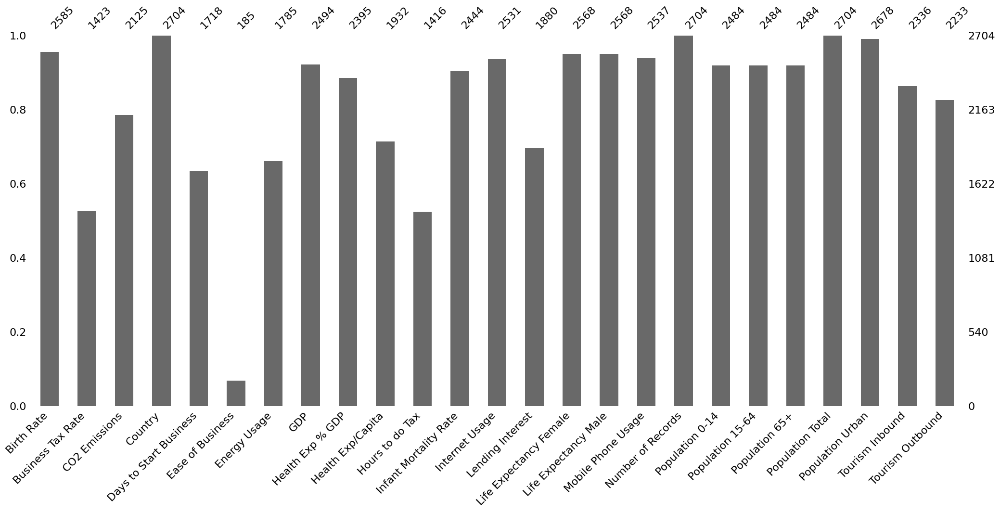

In [12]:
### visualizing the misssing value
import missingno as msno
msno.bar (df)
plt.show()

In [13]:
df.duplicated()

0       False
1       False
2       False
3       False
4       False
        ...  
2699    False
2700    False
2701    False
2702    False
2703    False
Length: 2704, dtype: bool

In [14]:
#sns.pairplot(data)

In [15]:
## Rename columns
df = df.rename(columns={'Birth Rate': 'BirthRate', 'Business Tax Rate': 'BusinessTaxRate','CO2 Emissions':'CO2Emissions','Days to Start Business':'DaystoStartBusiness','Ease of Business':'EaseofBusiness','Energy Usage':'EnergyUsage',
                            'Health Exp % GDP':'HealthExpGDP','Health Exp/Capita':'HealthExpCapita','Hours to do Tax':'HourstodoTax','Infant Mortality Rate':'InfantMortalityRate','Internet Usage':'InternetUsage','Lending Interest':'LendingInterest',
                            'Life Expectancy Female':'LifeExpectancyFemale','Life Expectancy Male':'LifeExpectancyMale','Mobile Phone Usage':'MobilePhoneUsage','Number of Records':'NumberofRecords','Population 0-14':'Population0to14',
                            'Population 15-64':'Population15to64','Population 65+':'Populationmorethan65','Population Total':'PopulationTotal','Population Urban':'PopulationUrban','Tourism Inbound':'TourismInbound','Tourism Outbound':'TourismOutbound'})
df.columns

Index(['BirthRate', 'BusinessTaxRate', 'CO2Emissions', 'Country',
       'DaystoStartBusiness', 'EaseofBusiness', 'EnergyUsage', 'GDP',
       'HealthExpGDP', 'HealthExpCapita', 'HourstodoTax',
       'InfantMortalityRate', 'InternetUsage', 'LendingInterest',
       'LifeExpectancyFemale', 'LifeExpectancyMale', 'MobilePhoneUsage',
       'NumberofRecords', 'Population0to14', 'Population15to64',
       'Populationmorethan65', 'PopulationTotal', 'PopulationUrban',
       'TourismInbound', 'TourismOutbound'],
      dtype='object')

In [16]:
## droping the columns

df.drop('NumberofRecords',axis=1,inplace=True)
df.drop('EaseofBusiness',axis=1,inplace=True)
df.drop('Population0to14',axis=1,inplace=True)
df.drop('Population15to64',axis=1,inplace=True)
df.drop('Populationmorethan65',axis=1,inplace=True)
df.drop('HourstodoTax',axis=1,inplace=True)
df.drop('LendingInterest',axis=1,inplace=True)

Filling up NaN values with mean or median

<Axes: xlabel='BirthRate', ylabel='Density'>

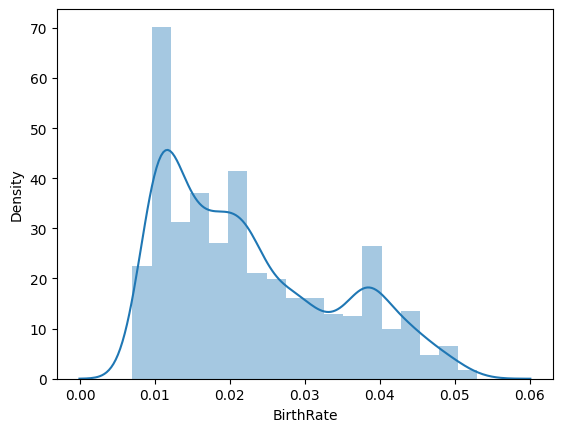

In [17]:
sns.distplot(df["BirthRate"])

In [18]:
df["BirthRate"].fillna(df["BirthRate"].median(),inplace=True)

In [19]:
df["BirthRate"].isnull().sum()

0

<Axes: xlabel='CO2Emissions', ylabel='Density'>

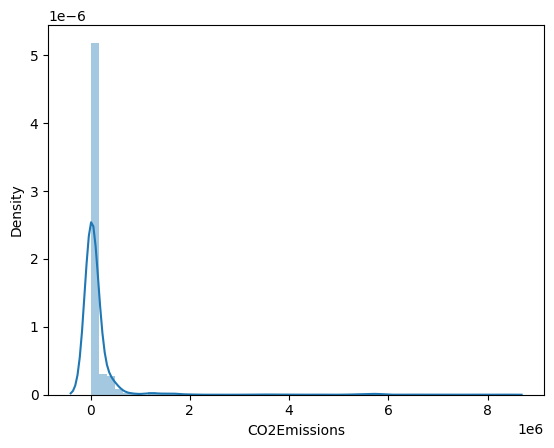

In [20]:
sns.distplot(df["CO2Emissions"])

In [21]:
df["CO2Emissions"].fillna(df["CO2Emissions"].median(),inplace=True)

In [22]:
df["CO2Emissions"].isnull().sum()

0

<Axes: xlabel='HealthExpGDP', ylabel='Density'>

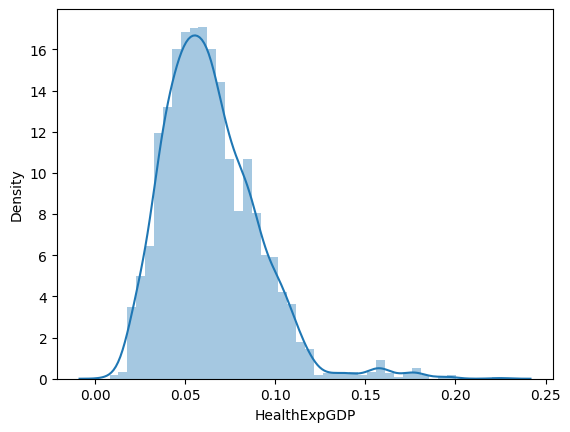

In [23]:
sns.distplot(df['HealthExpGDP'])

In [24]:
df["HealthExpGDP"].fillna(df["HealthExpGDP"].median(),inplace=True)

In [25]:
df["HealthExpGDP"].isnull().sum()

0

<Axes: xlabel='InfantMortalityRate', ylabel='Density'>

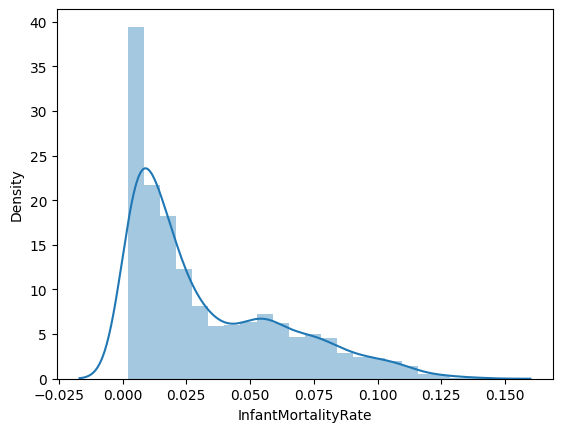

In [26]:
sns.distplot(df["InfantMortalityRate"])

In [27]:
df["InfantMortalityRate"].fillna(df["InfantMortalityRate"].median(),inplace=True)

In [28]:
df['InfantMortalityRate'].isna().sum()

0

<Axes: xlabel='InternetUsage', ylabel='Density'>

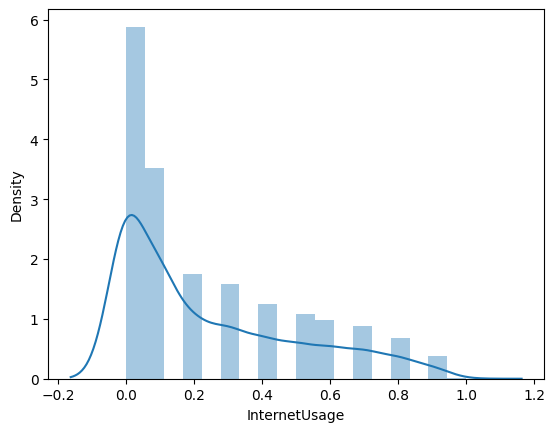

In [29]:
sns.distplot(df['InternetUsage'])

In [30]:
df['InternetUsage'].fillna(df['InternetUsage'].median(),inplace=True)

In [31]:
df['InternetUsage'].isna().sum()

0

<Axes: xlabel='LifeExpectancyFemale', ylabel='Density'>

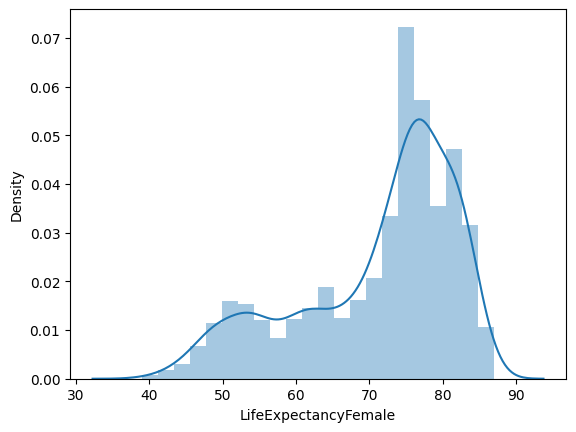

In [32]:
sns.distplot(df['LifeExpectancyFemale'])

In [33]:
df['LifeExpectancyFemale'].fillna(df['LifeExpectancyFemale'].median(),inplace=True)

In [34]:
df['LifeExpectancyFemale'].isna().sum()

0

<Axes: xlabel='LifeExpectancyMale', ylabel='Density'>

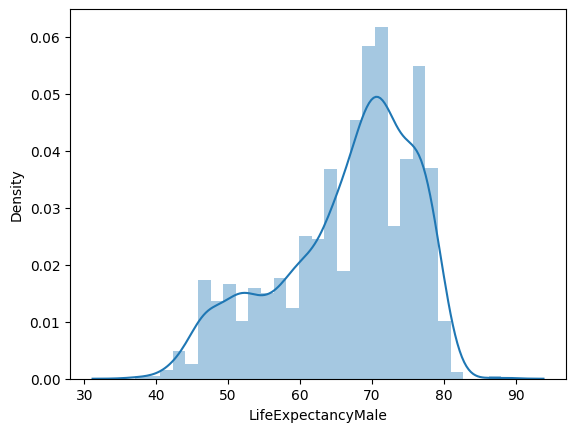

In [35]:
sns.distplot(df["LifeExpectancyMale"])

In [36]:
df['LifeExpectancyMale'].fillna(df['LifeExpectancyMale'].median(),inplace=True)

In [37]:
df['LifeExpectancyMale'].isna().sum()

0

<Axes: xlabel='MobilePhoneUsage', ylabel='Density'>

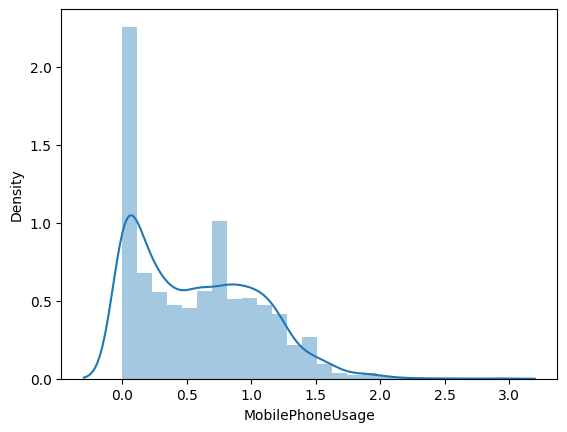

In [38]:
sns.distplot(df["MobilePhoneUsage"])

In [39]:
df['MobilePhoneUsage'].fillna(df['MobilePhoneUsage'].median(),inplace=True)

In [40]:
df['MobilePhoneUsage'].isna().sum()

0

<Axes: xlabel='PopulationUrban', ylabel='Density'>

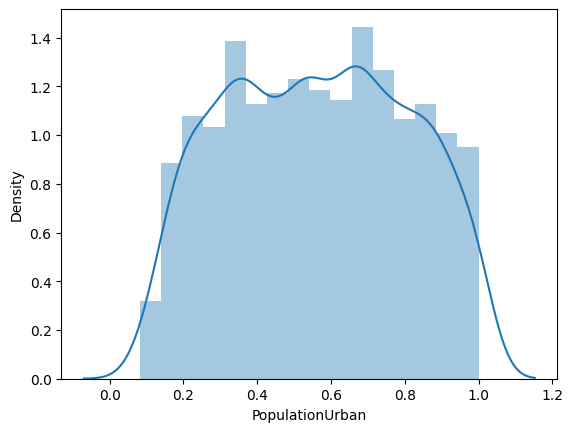

In [41]:
sns.distplot(df['PopulationUrban'])

In [42]:
df['PopulationUrban'].fillna(df['PopulationUrban'].median(),inplace=True)

In [43]:
df['PopulationUrban'].isna().sum()

0

<Axes: xlabel='DaystoStartBusiness', ylabel='Density'>

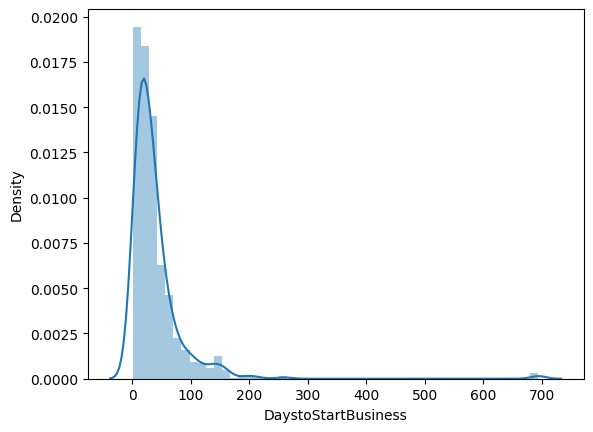

In [44]:
sns.distplot(df["DaystoStartBusiness"])

In [45]:
df['DaystoStartBusiness'].fillna(df['DaystoStartBusiness'].median(),inplace=True)

In [46]:
df["DaystoStartBusiness"].isnull().sum()

0

<Axes: xlabel='EnergyUsage', ylabel='Density'>

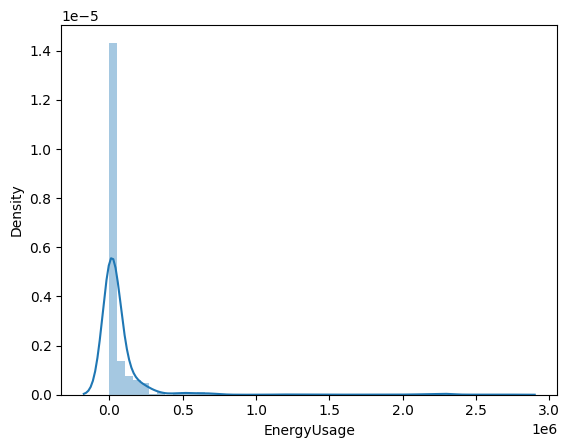

In [47]:
sns.distplot(df["EnergyUsage"])

In [48]:
df['EnergyUsage'].fillna(df['EnergyUsage'].median(),inplace=True)

In [49]:
df["EnergyUsage"].isnull().sum()

0

In [50]:
df.isna().sum()

BirthRate                  0
BusinessTaxRate         1281
CO2Emissions               0
Country                    0
DaystoStartBusiness        0
EnergyUsage                0
GDP                      210
HealthExpGDP               0
HealthExpCapita          772
InfantMortalityRate        0
InternetUsage              0
LifeExpectancyFemale       0
LifeExpectancyMale         0
MobilePhoneUsage           0
PopulationTotal            0
PopulationUrban            0
TourismInbound           368
TourismOutbound          471
dtype: int64

In [51]:
df.dtypes

BirthRate               float64
BusinessTaxRate         float64
CO2Emissions            float64
Country                  object
DaystoStartBusiness     float64
EnergyUsage             float64
GDP                     float64
HealthExpGDP            float64
HealthExpCapita         float64
InfantMortalityRate     float64
InternetUsage           float64
LifeExpectancyFemale    float64
LifeExpectancyMale      float64
MobilePhoneUsage        float64
PopulationTotal           int64
PopulationUrban         float64
TourismInbound          float64
TourismOutbound         float64
dtype: object

In [52]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
df.GDP=le.fit_transform(df.GDP)
df['HealthExpCapita']=le.fit_transform(df['HealthExpCapita'])
df['TourismInbound']=le.fit_transform(df['TourismInbound'])
df['TourismOutbound']=le.fit_transform(df['TourismOutbound'])
df['BusinessTaxRate']=le.fit_transform(df['BusinessTaxRate'])


In [53]:
df.isnull().sum()

BirthRate               0
BusinessTaxRate         0
CO2Emissions            0
Country                 0
DaystoStartBusiness     0
EnergyUsage             0
GDP                     0
HealthExpGDP            0
HealthExpCapita         0
InfantMortalityRate     0
InternetUsage           0
LifeExpectancyFemale    0
LifeExpectancyMale      0
MobilePhoneUsage        0
PopulationTotal         0
PopulationUrban         0
TourismInbound          0
TourismOutbound         0
dtype: int64

In [54]:
df.dtypes

BirthRate               float64
BusinessTaxRate           int64
CO2Emissions            float64
Country                  object
DaystoStartBusiness     float64
EnergyUsage             float64
GDP                       int64
HealthExpGDP            float64
HealthExpCapita           int64
InfantMortalityRate     float64
InternetUsage           float64
LifeExpectancyFemale    float64
LifeExpectancyMale      float64
MobilePhoneUsage        float64
PopulationTotal           int64
PopulationUrban         float64
TourismInbound            int64
TourismOutbound           int64
dtype: object

In [55]:
df1=df.copy()

In [56]:
df

,BirthRate,BusinessTaxRate,CO2Emissions,Country,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
0,0.020,447,87931.0,Algeria,26.0,26998.0,1696,0.035,58,0.034,0.0,71.0,67.0,0.0,31719449,0.599,185,245
1,0.050,447,9542.0,Angola,26.0,7499.0,1016,0.034,20,0.128,0.0,47.0,44.0,0.0,13924930,0.324,110,206
2,0.043,447,1617.0,Benin,26.0,1983.0,498,0.043,13,0.090,0.0,57.0,53.0,0.0,6949366,0.383,161,115
3,0.027,447,4276.0,Botswana,26.0,1836.0,816,0.047,147,0.054,0.0,52.0,49.0,0.1,1755375,0.532,281,260
4,0.046,447,1041.0,Burkina Faso,26.0,14338.0,529,0.051,10,0.096,0.0,52.0,49.0,0.0,11607944,0.178,95,89
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2699,0.020,447,8529.0,Turks and Caicos Islands,26.0,14338.0,2494,0.061,626,0.020,0.1,75.0,69.0,0.5,32427,0.911,1650,1457
2700,0.013,241,8529.0,United States,5.0,2132446.0,2493,0.179,626,0.006,0.8,81.0,76.0,1.0,313873685,0.811,1649,1456
2701,0.015,200,8529.0,Uruguay,7.0,14338.0,1670,0.089,626,0.010,0.5,80.0,74.0,1.5,3395253,0.948,927,683
2702,0.020,346,8529.0,"Venezuela, RB",144.0,14338.0,2218,0.046,478,0.013,0.5,78.0,72.0,1.0,29954782,0.889,644,938


In [57]:
df.drop("Country",axis=1,inplace=True)

Outliers Representation

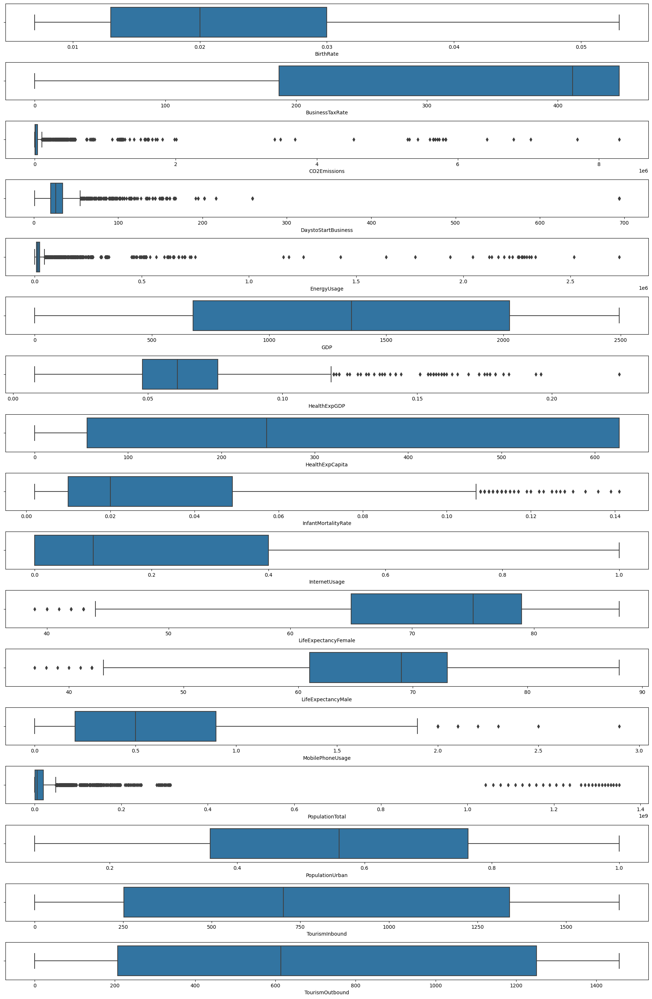

In [58]:
plt.figure(figsize=(18,40))
for i, j in enumerate(df.columns):
    plt.subplot(25,1, i+1)
    sns.boxplot(x=df[j])
    plt.xlabel(j)
    plt.tight_layout()

Handling Outliers

In [59]:
#outliers
q3 = np.percentile(df["CO2Emissions"],75)
q1 = np.percentile(df["CO2Emissions"],25)

iqr = q3-q1
ub = q3+1.5*iqr
lb = q1-1.5*iqr

In [60]:
df[df["CO2Emissions"]>ub]

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
14,0.025,447,141326.0,26.0,40658.0,1844,0.054,77,0.036,0.0,71.0,66.0,0.0,66136590,0.428,1141,713
43,0.024,447,368611.0,26.0,109264.0,1930,0.083,234,0.052,0.1,58.0,54.0,0.2,44000000,0.569,1049,906
60,0.014,447,3405180.0,26.0,1161353.0,2369,0.046,41,0.030,0.0,74.0,71.0,0.1,1262645000,0.359,1489,1267
63,0.026,447,1186663.0,26.0,457198.0,2260,0.043,18,0.067,0.0,63.0,61.0,0.0,1042261758,0.277,1070,978
64,0.022,447,263419.0,26.0,154768.0,1983,0.020,13,0.041,0.0,69.0,65.0,0.0,208938698,0.420,1161,937
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2251,0.016,369,419754.0,119.0,265887.0,2429,0.090,621,0.015,0.4,77.0,70.0,1.0,195210154,0.843,1231,1318
2252,0.011,81,499137.0,5.0,250992.0,2401,0.114,626,0.005,0.8,83.0,79.0,0.8,34005274,0.809,1505,1390
2270,0.020,279,443674.0,7.0,178924.0,2356,0.063,483,0.014,0.3,79.0,74.0,0.8,117886404,0.778,1424,1176
2284,0.013,242,5433057.0,5.0,2215504.0,2491,0.177,626,0.006,0.7,81.0,76.0,0.9,309326295,0.808,1646,1452


In [61]:
df["CO2Emissions"][df["CO2Emissions"]>ub]=ub

<Axes: >

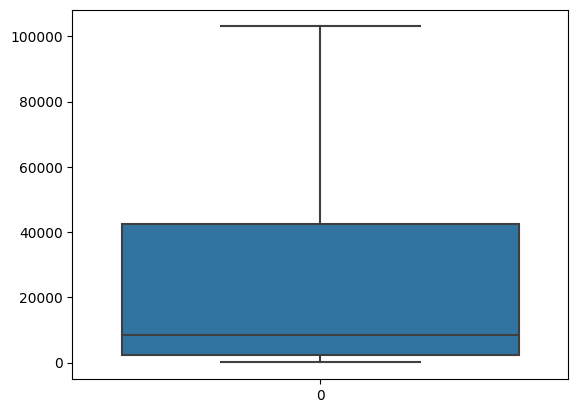

In [62]:
sns.boxplot(df["CO2Emissions"])

In [63]:
q3 = np.percentile(df["DaystoStartBusiness"],75)
q1 = np.percentile(df["DaystoStartBusiness"],25)

iqr = q3-q1
ub = q3+1.5*iqr
lb = q1-1.5*iqr

In [64]:
df[df["DaystoStartBusiness"]>ub]

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
625,0.050,447,9065.0,119.0,9004.0,1222,0.049,43,0.125,0.0,49.0,46.0,0.0,15421075,0.346,145,114
627,0.026,447,4265.0,107.0,1907.0,919,0.043,181,0.051,0.0,48.0,47.0,0.2,1832602,0.546,434,281
632,0.050,447,381.0,64.0,14338.0,544,0.058,15,0.103,0.0,48.0,46.0,0.0,9311234,0.217,1650,1457
634,0.047,447,1698.0,166.0,18503.0,1004,0.051,4,0.111,0.0,49.0,46.0,0.0,50972323,0.365,1650,1457
636,0.037,447,5460.0,62.0,6578.0,1206,0.051,40,0.094,0.0,47.0,46.0,0.1,16909801,0.455,160,496
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2672,0.015,314,8529.0,60.0,14338.0,1637,0.101,610,0.009,0.5,82.0,78.0,1.1,4805295,0.739,971,506
2677,0.021,136,8529.0,56.0,14338.0,1798,0.064,331,0.020,0.4,79.0,73.0,1.1,15492264,0.631,685,658
2683,0.026,187,8529.0,105.0,14338.0,938,0.064,51,0.056,0.1,65.0,61.0,0.6,10173775,0.548,243,449
2697,0.018,83,8529.0,694.0,14338.0,753,0.059,437,0.021,0.3,74.0,68.0,1.1,534541,0.662,162,124


In [65]:
df["DaystoStartBusiness"][df["DaystoStartBusiness"]>ub]=ub

<Axes: >

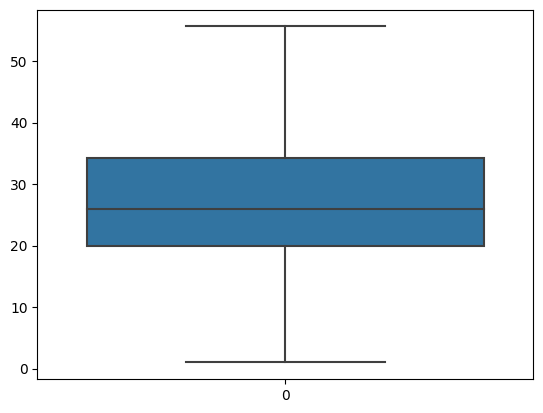

In [66]:
sns.boxplot(df["DaystoStartBusiness"])

In [67]:
q3 = np.percentile(df["EnergyUsage"],75)
q1 = np.percentile(df["EnergyUsage"],25)

iqr = q3-q1
ub = q3+1.5*iqr
lb = q1-1.5*iqr

In [68]:
df[df["EnergyUsage"]>ub]

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
36,0.043,447,79182.0,26.0,90596.0,1645,0.046,15,0.113,0.0,47.0,46.0,0.0,122876727,0.348,252,524
43,0.024,447,103049.5,26.0,109264.0,1930,0.083,234,0.052,0.1,58.0,54.0,0.2,44000000,0.569,1049,906
60,0.014,447,103049.5,26.0,1161353.0,2369,0.046,41,0.030,0.0,74.0,71.0,0.1,1262645000,0.359,1489,1267
63,0.026,447,103049.5,26.0,457198.0,2260,0.043,18,0.067,0.0,63.0,61.0,0.0,1042261758,0.277,1070,978
64,0.022,447,103049.5,26.0,154768.0,1983,0.020,13,0.041,0.0,69.0,65.0,0.0,208938698,0.420,1161,937
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2630,0.013,140,8529.0,12.0,192381.0,2440,0.094,626,0.004,0.9,84.0,80.0,1.2,63695687,0.818,1604,1426
2645,0.014,249,8529.0,3.0,133681.0,2398,0.091,626,0.004,0.8,84.0,80.0,1.1,22723900,0.890,1573,1383
2668,0.011,59,8529.0,5.0,252651.0,2412,0.109,626,0.005,0.8,83.0,79.0,0.8,34754312,0.813,1530,1404
2686,0.019,295,8529.0,6.0,191924.0,2368,0.061,490,0.013,0.4,80.0,75.0,0.8,120847477,0.784,1445,1214


In [69]:
df["EnergyUsage"][df["EnergyUsage"]>ub]=ub

<Axes: >

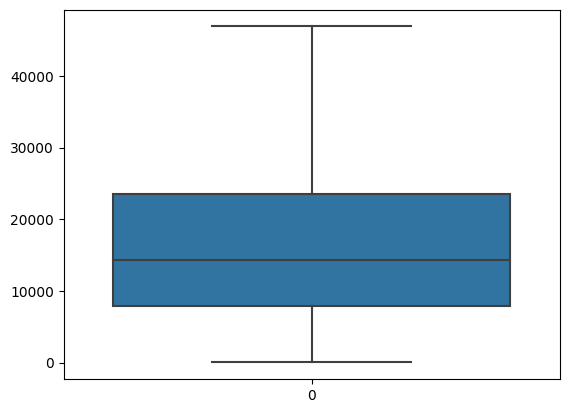

In [70]:
sns.boxplot(df["EnergyUsage"])

In [71]:
q3 = np.percentile(df["HealthExpGDP"],75)
q1 = np.percentile(df["HealthExpGDP"],25)

iqr = q3-q1
ub = q3+1.5*iqr
lb = q1-1.5*iqr

In [72]:
df[df["HealthExpGDP"]>ub]

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
41,0.044,447,425.0,26.0,14338.000,179,0.184,26,0.141,0.0,39.0,37.0,0.0,4139757,0.356,62,95
154,0.020,447,77.0,26.0,14338.000,12,0.225,409,0.034,0.0,68.0,63.0,0.0,52161,0.684,19,0
204,0.014,447,103049.5,26.0,46913.625,2481,0.136,626,0.007,0.4,79.0,74.0,0.4,282162411,0.791,1641,1441
249,0.044,447,568.0,26.0,14338.000,302,0.160,38,0.139,0.0,40.0,38.0,0.0,4295667,0.359,77,106
362,0.020,447,81.0,26.0,14338.000,13,0.194,372,0.033,0.0,75.0,69.0,0.0,52184,0.687,20,1
412,0.014,447,103049.5,26.0,46913.625,2482,0.142,626,0.007,0.5,79.0,74.0,0.4,284968955,0.792,1639,1437
457,0.043,447,609.0,26.0,14338.000,334,0.160,42,0.136,0.0,40.0,39.0,0.0,4493047,0.361,116,101
570,0.020,447,84.0,26.0,14338.000,16,0.182,376,0.033,0.0,75.0,69.0,0.0,52161,0.690,23,1
620,0.014,447,103049.5,26.0,46913.625,2483,0.151,626,0.007,0.6,80.0,74.0,0.5,287625193,0.794,1638,1433
665,0.043,447,653.0,26.0,14338.000,371,0.155,43,0.133,0.0,41.0,40.0,0.0,4712763,0.364,141,100


In [73]:
df["HealthExpGDP"][df["HealthExpGDP"]>ub]=ub

<Axes: >

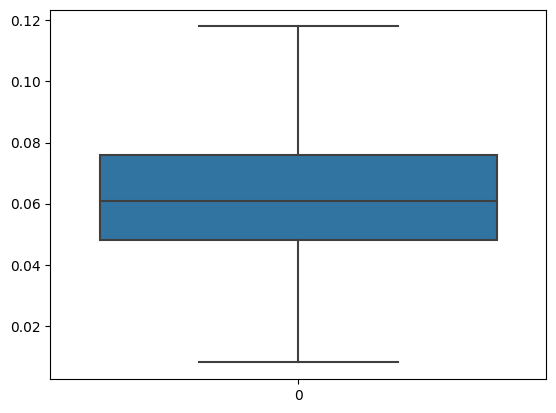

In [74]:
sns.boxplot(df['HealthExpGDP'])

In [75]:
q3 = np.percentile(df["InfantMortalityRate"],75)
q1 = np.percentile(df["InfantMortalityRate"],25)

iqr = q3-q1
ub = q3+1.5*iqr
lb = q1-1.5*iqr

In [76]:
df[df["InfantMortalityRate"]>ub]

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
1,0.050,447,9542.0,26.000,7499.000,1016,0.034,20,0.128,0.0,47.0,44.0,0.0,13924930,0.324,110,206
7,0.039,447,268.0,26.000,14338.000,271,0.043,9,0.113,0.0,45.0,42.0,0.0,3638316,0.376,31,92
10,0.048,447,1646.0,26.000,16679.000,1336,0.048,12,0.115,0.0,48.0,45.0,0.0,46949244,0.351,1650,1457
22,0.042,447,147.0,26.000,14338.000,82,0.049,14,0.109,0.0,53.0,50.0,0.5,1273312,0.367,1650,1457
25,0.043,447,436.0,26.000,14338.000,141,0.059,9,0.119,0.0,53.0,52.0,0.0,2891968,0.443,1650,1457
29,0.048,447,543.0,26.000,14338.000,504,0.063,14,0.116,0.0,49.0,49.0,0.0,10260577,0.284,128,132
33,0.044,447,1349.0,26.000,7173.000,695,0.062,13,0.114,0.0,49.0,46.0,0.0,18275618,0.291,158,183
36,0.043,447,79182.0,26.000,46913.625,1645,0.046,15,0.113,0.0,47.0,46.0,0.0,122876727,0.348,252,524
37,0.041,447,686.0,26.000,14338.000,424,0.042,7,0.108,0.0,49.0,47.0,0.0,8395577,0.149,102,95
41,0.044,447,425.0,26.000,14338.000,179,0.118,26,0.141,0.0,39.0,37.0,0.0,4139757,0.356,62,95


In [77]:
df["InfantMortalityRate"][df["InfantMortalityRate"]>ub]=ub

<Axes: >

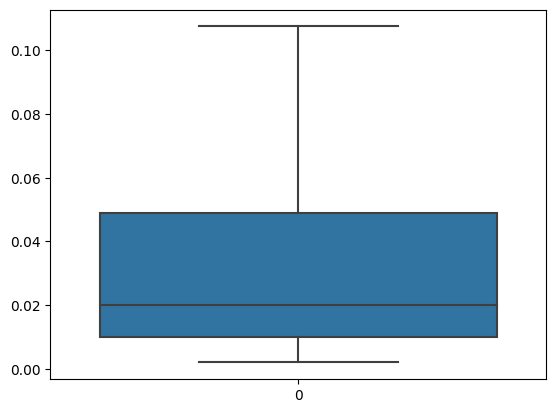

In [78]:
sns.boxplot(df["InfantMortalityRate"])

In [79]:
q3 = np.percentile(df["LifeExpectancyFemale"],75)
q1 = np.percentile(df["LifeExpectancyFemale"],25)

iqr = q3-q1
ub = q3+1.5*iqr
lb = q1-1.5*iqr

In [80]:
df[df["LifeExpectancyFemale"]<lb]

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
41,0.044,447,425.0,26.000,14338.0,179,0.118,26,0.1075,0.0,39.0,37.0,0.0,4139757,0.356,62,95
51,0.045,447,1819.0,26.000,6244.0,598,0.056,16,0.1000,0.0,42.0,42.0,0.0,10100981,0.348,151,165
249,0.044,447,568.0,26.000,14338.0,302,0.118,38,0.1075,0.0,40.0,38.0,0.0,4295667,0.359,77,106
259,0.045,447,1907.0,26.000,6430.0,633,0.060,19,0.0950,0.0,43.0,42.0,0.0,10362137,0.350,163,165
260,0.032,447,12563.0,26.000,9690.0,888,0.061,626,0.0600,0.0,43.0,43.0,0.0,12586763,0.342,164,1457
457,0.043,447,609.0,26.000,14338.0,334,0.118,42,0.1075,0.0,40.0,39.0,0.0,4493047,0.361,116,101
468,0.032,447,11932.0,26.000,9692.0,858,0.061,626,0.0590,0.0,43.0,43.0,0.0,12640922,0.346,160,1457
665,0.043,447,653.0,26.000,14338.0,371,0.118,43,0.1075,0.0,41.0,40.0,0.0,4712763,0.364,141,100
676,0.032,447,10627.0,55.625,9500.0,810,0.061,626,0.0580,0.1,42.0,43.0,0.0,12673103,0.345,143,1457
873,0.042,447,642.0,26.000,14338.0,379,0.118,43,0.1075,0.0,42.0,41.0,0.5,4928175,0.366,139,89


In [81]:
df["LifeExpectancyFemale"][df["LifeExpectancyFemale"]<lb]=lb

<Axes: >

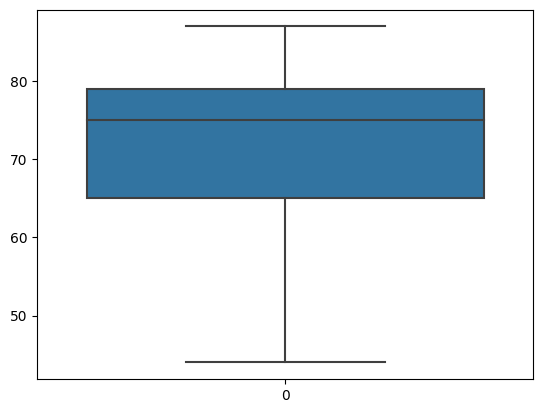

In [82]:
sns.boxplot(df["LifeExpectancyFemale"])

In [83]:
q3 = np.percentile(df["LifeExpectancyMale"],75)
q1 = np.percentile(df["LifeExpectancyMale"],25)

iqr = q3-q1
ub = q3+1.5*iqr
lb = q1-1.5*iqr

In [84]:
df[df["LifeExpectancyMale"]<lb]

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
7,0.039,447,268.0,26.0,14338.0,271,0.043,9,0.1075,0.0,45.0,42.0,0.0,3638316,0.376,31,92
41,0.044,447,425.0,26.0,14338.0,179,0.118,26,0.1075,0.0,44.0,37.0,0.0,4139757,0.356,62,95
51,0.045,447,1819.0,26.0,6244.0,598,0.056,16,0.1000,0.0,44.0,42.0,0.0,10100981,0.348,151,165
215,0.039,447,246.0,26.0,14338.0,274,0.040,8,0.1075,0.0,45.0,42.0,0.0,3704045,0.377,31,86
249,0.044,447,568.0,26.0,14338.0,302,0.118,38,0.1075,0.0,44.0,38.0,0.0,4295667,0.359,77,106
259,0.045,447,1907.0,26.0,6430.0,633,0.060,19,0.0950,0.0,44.0,42.0,0.0,10362137,0.350,163,165
423,0.039,447,246.0,26.0,14338.0,286,0.042,9,0.1075,0.0,46.0,42.0,0.0,3767248,0.378,19,86
457,0.043,447,609.0,26.0,14338.0,334,0.118,42,0.1075,0.0,44.0,39.0,0.0,4493047,0.361,116,101
665,0.043,447,653.0,26.0,14338.0,371,0.118,43,0.1075,0.0,44.0,40.0,0.0,4712763,0.364,141,100
873,0.042,447,642.0,26.0,14338.0,379,0.118,43,0.1075,0.0,44.0,41.0,0.5,4928175,0.366,139,89


In [85]:
df["LifeExpectancyMale"][df["LifeExpectancyMale"]<lb]=lb

<Axes: >

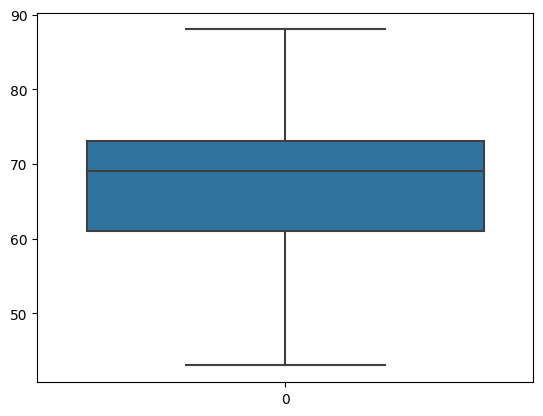

In [86]:
sns.boxplot(df["LifeExpectancyMale"])

In [87]:
q3 = np.percentile(df["MobilePhoneUsage"],75)
q1 = np.percentile(df["MobilePhoneUsage"],25)

iqr = q3-q1
ub = q3+1.5*iqr
lb = q1-1.5*iqr

In [88]:
df[df["MobilePhoneUsage"]>ub]

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
1629,0.014,447,612.0,26.0,14338.0,2494,0.061,626,0.020,0.5,75.0,69.0,2.0,51472,1.000,447,192
1943,0.009,447,1302.0,26.0,14338.0,1389,0.061,626,0.020,0.5,82.0,77.0,2.0,521617,1.000,1506,668
1990,0.012,71,1822.0,12.0,994.0,682,0.063,381,0.007,0.4,77.0,72.0,2.1,619408,0.629,599,142
2045,0.016,447,587.0,26.0,14338.0,2494,0.061,626,0.020,0.6,75.0,69.0,2.0,54275,1.000,433,181
2142,0.013,51,36289.0,6.0,13838.0,2092,0.061,626,0.020,0.7,86.0,80.0,2.0,7024200,1.000,1553,1305
2151,0.009,447,1030.0,26.0,14338.0,1492,0.061,626,0.020,0.6,82.0,77.0,2.1,534626,1.000,1558,719
2350,0.014,51,8529.0,3.0,14894.0,2119,0.061,626,0.020,0.7,87.0,80.0,2.2,7071600,1.000,1571,1315
2359,0.010,447,8529.0,26.0,14338.0,1571,0.061,626,0.020,0.6,82.0,78.0,2.5,546278,1.000,1586,766
2451,0.017,193,8529.0,21.0,14338.0,310,0.055,531,0.008,0.5,78.0,73.0,2.0,88152,0.257,349,115
2558,0.013,51,8529.0,3.0,14338.0,2141,0.061,626,0.020,0.7,86.0,81.0,2.3,7154600,1.000,1581,1323


In [89]:
df["MobilePhoneUsage"][df["MobilePhoneUsage"]>ub]=ub

<Axes: >

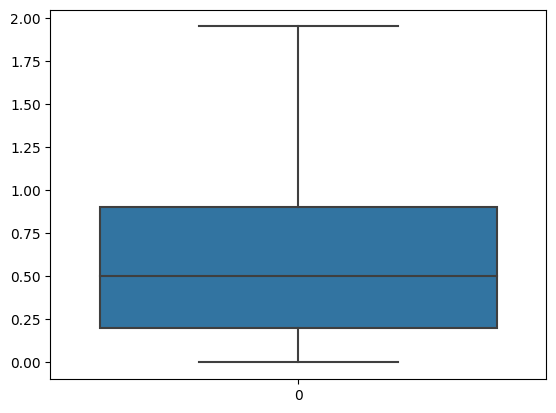

In [90]:
sns.boxplot(df["MobilePhoneUsage"])

In [91]:
q3 = np.percentile(df["PopulationTotal"], 75)
q1 = np.percentile(df["PopulationTotal"], 25)

iqr = q3 - q1
ub = q3+1.5*iqr
lb = q1-1.5*iqr

In [92]:
df[df["PopulationTotal"]>ub]

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
14,0.025,447,103049.5,26.000,40658.000,1844,0.054,77,0.0360,0.0,71.0,66.0,0.0,66136590,0.428,1141,713
17,0.044,447,5831.0,26.000,25242.000,953,0.043,3,0.0900,0.0,53.0,51.0,0.0,66024199,0.147,266,145
36,0.043,447,79182.0,26.000,46913.625,1645,0.046,15,0.1075,0.0,47.0,46.0,0.0,122876727,0.348,252,524
56,0.027,447,27869.0,26.000,18591.000,1650,0.028,8,0.0640,0.0,66.0,65.0,0.0,132383265,0.236,131,446
60,0.014,447,103049.5,26.000,46913.625,2369,0.046,41,0.0300,0.0,74.0,71.0,0.1,1262645000,0.359,1489,1267
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2630,0.013,140,8529.0,12.000,46913.625,2440,0.094,626,0.0040,0.9,84.0,80.0,1.2,63695687,0.818,1604,1426
2632,0.019,221,8529.0,16.000,14338.000,2268,0.067,423,0.0150,0.3,76.0,72.0,0.8,76424443,0.718,1650,1457
2667,0.015,379,8529.0,55.625,14338.000,2433,0.093,626,0.0130,0.5,77.0,70.0,1.3,198656019,0.849,1261,1362
2686,0.019,295,8529.0,6.000,46913.625,2368,0.061,490,0.0130,0.4,80.0,75.0,0.8,120847477,0.784,1445,1214


In [93]:
df["PopulationTotal"][df["PopulationTotal"]>ub]=ub

<Axes: >

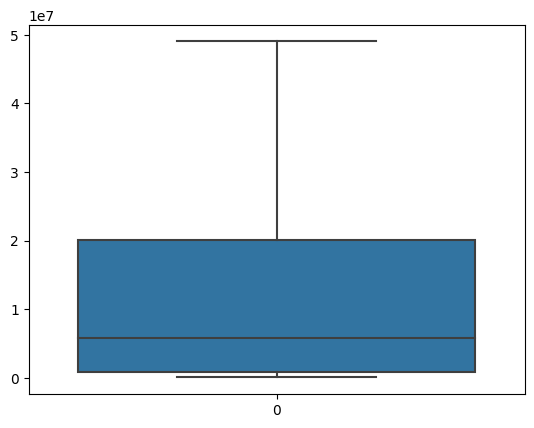

In [94]:
sns.boxplot(df["PopulationTotal"])

In [95]:
df

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
0,0.020,447,87931.0,26.000,26998.000,1696,0.035,58,0.0340,0.0,71.0,67.0,0.0,3.171945e+07,0.599,185,245
1,0.050,447,9542.0,26.000,7499.000,1016,0.034,20,0.1075,0.0,47.0,44.0,0.0,1.392493e+07,0.324,110,206
2,0.043,447,1617.0,26.000,1983.000,498,0.043,13,0.0900,0.0,57.0,53.0,0.0,6.949366e+06,0.383,161,115
3,0.027,447,4276.0,26.000,1836.000,816,0.047,147,0.0540,0.0,52.0,49.0,0.1,1.755375e+06,0.532,281,260
4,0.046,447,1041.0,26.000,14338.000,529,0.051,10,0.0960,0.0,52.0,49.0,0.0,1.160794e+07,0.178,95,89
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2699,0.020,447,8529.0,26.000,14338.000,2494,0.061,626,0.0200,0.1,75.0,69.0,0.5,3.242700e+04,0.911,1650,1457
2700,0.013,241,8529.0,5.000,46913.625,2493,0.118,626,0.0060,0.8,81.0,76.0,1.0,4.903473e+07,0.811,1649,1456
2701,0.015,200,8529.0,7.000,14338.000,1670,0.089,626,0.0100,0.5,80.0,74.0,1.5,3.395253e+06,0.948,927,683
2702,0.020,346,8529.0,55.625,14338.000,2218,0.046,478,0.0130,0.5,78.0,72.0,1.0,2.995478e+07,0.889,644,938


In [96]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scale_data=scaler.fit_transform(df)

In [97]:
scale_data

array([[-0.23386408,  0.86272577,  1.6597329 , ...,  0.14744887,
        -1.0812375 , -0.89937449],
       [ 2.46933546,  0.86272577, -0.48614244, ..., -0.97652967,
        -1.21385396, -0.9744957 ],
       [ 1.8385889 ,  0.86272577, -0.70308693, ..., -0.73538518,
        -1.12367477, -1.14977853],
       ...,
       [-0.68439734, -0.80267164, -0.51387301, ...,  1.57387983,
         0.23078143, -0.0557055 ],
       [-0.23386408,  0.1817333 , -0.51387301, ...,  1.33273534,
        -0.26962471,  0.43547166],
       [-1.04482395,  0.86272577, -0.51387301, ...,  1.57796703,
         1.50920418,  1.43516163]])

Data Visualization

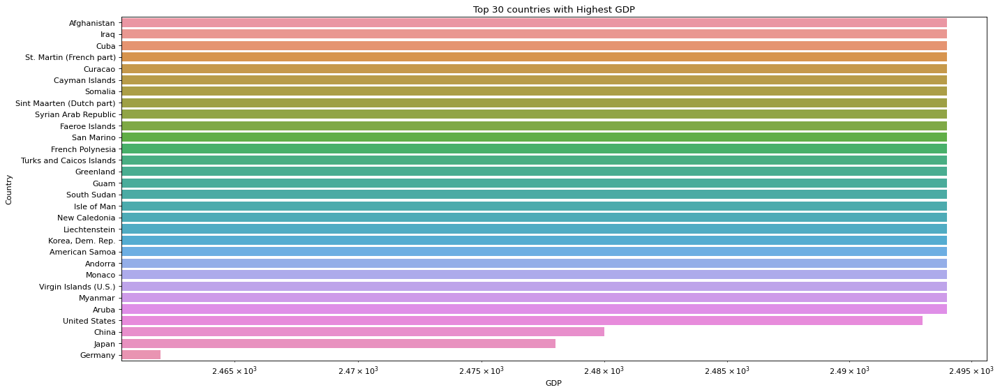

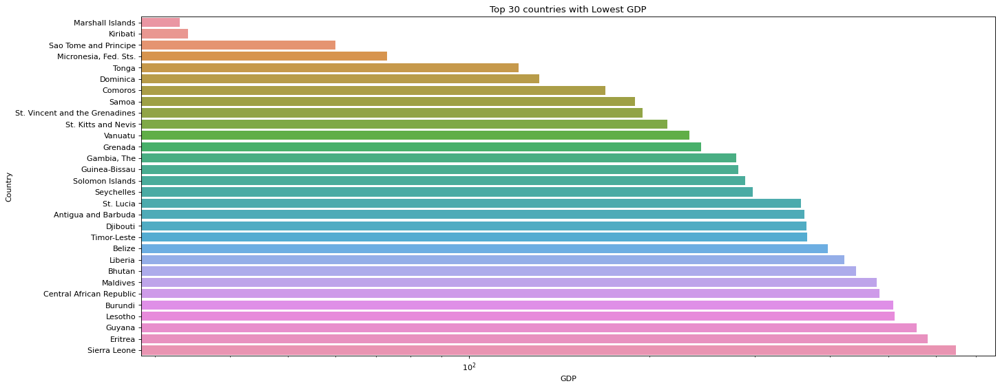

In [98]:
df_gdp_country = df1.groupby('Country', group_keys=False).apply(lambda x: x.loc[x.GDP.idxmax()])

# df_gdp_country
top40 = df_gdp_country['GDP'].sort_values(ascending=False)[:30]
bot40 = df_gdp_country['GDP'].sort_values()[:30]

plt.figure(figsize=(20,8), dpi=80)
top = sns.barplot(x=top40, y=top40.index, log=True)
plt.title('Top 30 countries with Highest GDP')
plt.show()

plt.figure(figsize=(20,8), dpi=80)
bot = sns.barplot(x=bot40, y=bot40.index, log=True)
plt.title('Top 30 countries with Lowest GDP')
plt.show()

In [99]:
df.corr()

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
BirthRate,1.000000,0.039334,-0.351731,0.263394,-0.283022,-0.419351,-0.238268,-0.661378,0.870159,-0.624617,-0.865210,-0.822416,-0.538916,0.012781,-0.592360,-0.383530,-0.289416
BusinessTaxRate,0.039334,1.000000,0.022730,0.081669,0.010693,-0.023552,-0.092725,-0.028926,0.134494,-0.255948,-0.062906,-0.094499,-0.430741,-0.012173,0.037368,0.011776,0.068001
CO2Emissions,-0.351731,0.022730,1.000000,-0.072469,0.834030,0.585255,0.056862,0.178091,-0.299015,0.188934,0.312254,0.295870,0.142886,0.629085,0.298178,0.366357,0.393164
DaystoStartBusiness,0.263394,0.081669,-0.072469,1.000000,-0.154774,-0.171154,-0.225340,-0.294567,0.260893,-0.388139,-0.301963,-0.312340,-0.317268,0.011781,-0.230867,-0.200846,-0.142689
EnergyUsage,-0.283022,0.010693,0.834030,-0.154774,1.000000,0.601071,0.106609,0.214008,-0.224241,0.282114,0.256495,0.250669,0.195398,0.706726,0.248088,0.425923,0.459616
GDP,-0.419351,-0.023552,0.585255,-0.171154,0.601071,1.000000,0.097411,0.488844,-0.371113,0.400037,0.425750,0.419702,0.365182,0.511740,0.502005,0.540931,0.525690
HealthExpGDP,-0.238268,-0.092725,0.056862,-0.225340,0.106609,0.097411,1.000000,0.342051,-0.206844,0.349519,0.221774,0.232064,0.198396,-0.024224,0.191847,0.133383,0.099859
HealthExpCapita,-0.661378,-0.028926,0.178091,-0.294567,0.214008,0.488844,0.342051,1.000000,-0.645672,0.735257,0.653932,0.665818,0.618824,-0.168656,0.661251,0.530792,0.479561
InfantMortalityRate,0.870159,0.134494,-0.299015,0.260893,-0.224241,-0.371113,-0.206844,-0.645672,1.000000,-0.615956,-0.924283,-0.901555,-0.571014,0.058261,-0.600789,-0.347110,-0.254463
InternetUsage,-0.624617,-0.255948,0.188934,-0.388139,0.282114,0.400037,0.349519,0.735257,-0.615956,1.000000,0.639727,0.659313,0.744721,-0.030459,0.531437,0.450052,0.368743


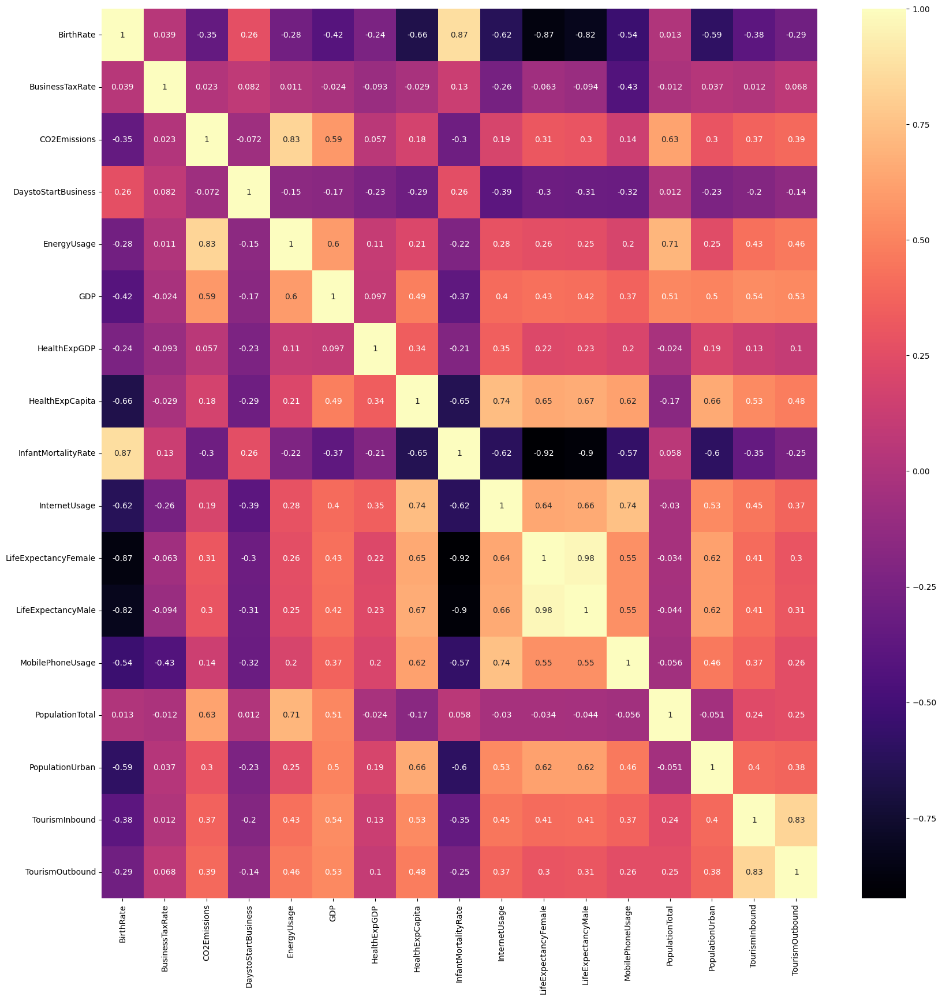

In [100]:
plt.figure(figsize=(20,20))
sns.heatmap(df.corr(),cmap="magma",annot=True)
plt.show()

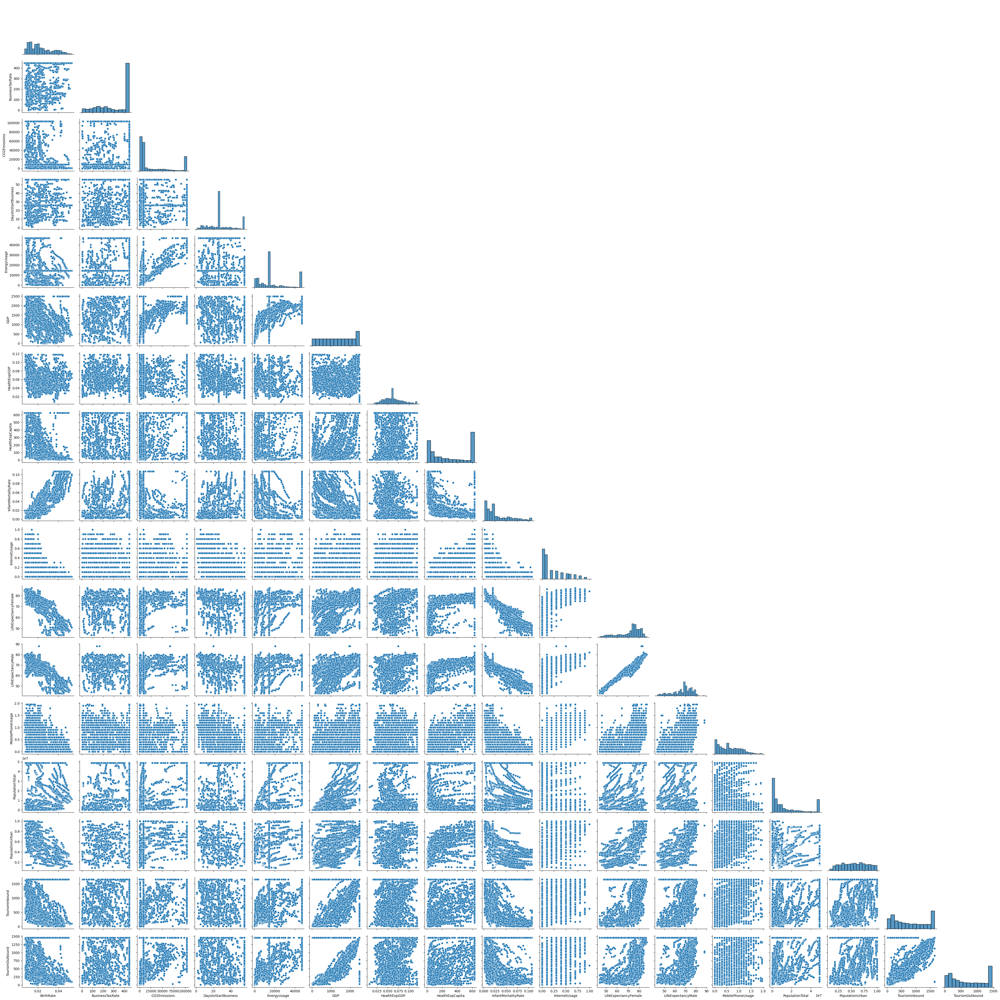

In [101]:
sns.pairplot(data=df,corner=True)

In [102]:
!pip install autoviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.3/68.3 kB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.5/18.5 MB 68.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 397.5/397.5 kB 40.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 85.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 98.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 80.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 255.9/255.9 MB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.3/87.3 kB 11.5 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of panel to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.8/20.8 MB 62.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.8/20.8 MB 68.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.1/2

In [103]:
from autoviz.AutoViz_Class import AutoViz_Class
%matplotlib inline

Imported v0.1.803. After importing autoviz, you must run '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


Shape of your Data Set loaded: (2704, 25)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  16
    Number of Integer-Categorical Columns =  1
    Number of String-Categorical Columns =  1
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  2
    Number of NLP String Columns =  3
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  2
    25 Predictors classified...
        2 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['Ease of Business', 'Number of Records']
To fix these data quality

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
Birth Rate,float64,4.400888,NA,0.007000,0.053000,"119 missing values. Impute them with mean, median, mode, or a constant value such as 123."
Business Tax Rate,object,47.374260,16,,,"1281 missing values. Impute them with mean, median, mode, or a constant value such as 123., Mixed dtypes: has 2 different data types: float, object,, Possible high cardinality column with 447 unique values: Use hash encoding or text embedding to reduce dimension."
CO2 Emissions,float64,21.412722,NA,7.000000,8286892.000000,"579 missing values. Impute them with mean, median, mode, or a constant value such as 123., Column has 317 outliers greater than upper bound (145730.00) or lower than lower bound(-85262.00). Cap them or remove them."
Country,object,0.000000,7,,,Possible high cardinality column with 208 unique values: Use hash encoding or text embedding to reduce dimension.
Days to Start Business,float64,36.464497,NA,1.000000,694.000000,"986 missing values. Impute them with mean, median, mode, or a constant value such as 123., Column has 138 outliers greater than upper bound (93.00) or lower than lower bound(-35.00). Cap them or remove them."
Ease of Business,float64,93.158284,6,,,"Possible Zero-variance or low information colum: drop before modeling step., 2519 missing values. Impute them with mean, median, mode, or a constant value such as 123."
Energy Usage,float64,33.986686,NA,8.000000,2727728.000000,"919 missing values. Impute them with mean, median, mode, or a constant value such as 123., Column has 272 outliers greater than upper bound (99024.50) or lower than lower bound(-53435.50). Cap them or remove them., Column has a high correlation with ['CO2 Emissions']. Consider dropping one of them."
GDP,object,7.766272,92,,,"210 missing values. Impute them with mean, median, mode, or a constant value such as 123., 2494 rare categories: Too many to list. Group them into a single category or drop the categories., Mixed dtypes: has 2 different data types: object, float,"
Health Exp % GDP,float64,11.427515,NA,0.008000,0.225000,"309 missing values. Impute them with mean, median, mode, or a constant value such as 123., Column has 48 outliers greater than upper bound (0.13) or lower than lower bound(-0.00). Cap them or remove them."
Health Exp/Capita,object,11.427515,39,,,"309 missing values. Impute them with mean, median, mode, or a constant value such as 123., Mixed dtypes: has 2 different data types: object, float,"


Number of All Scatter Plots = 136


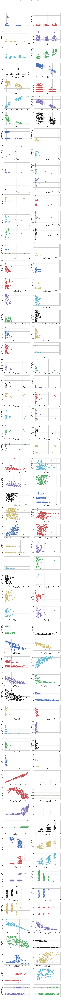

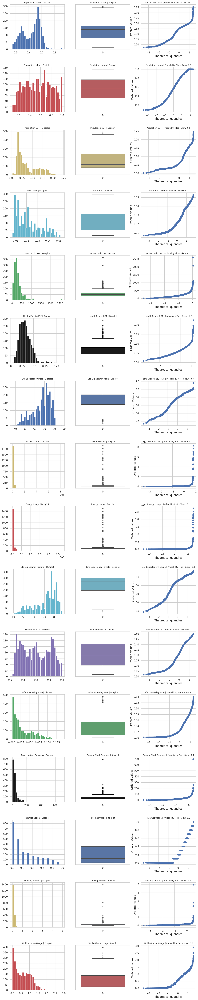

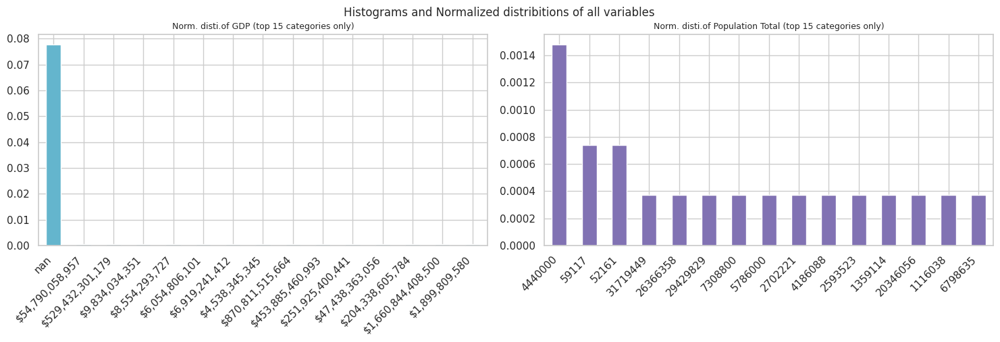

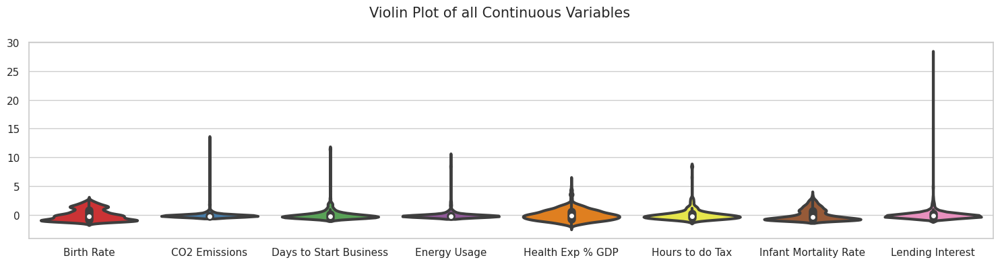

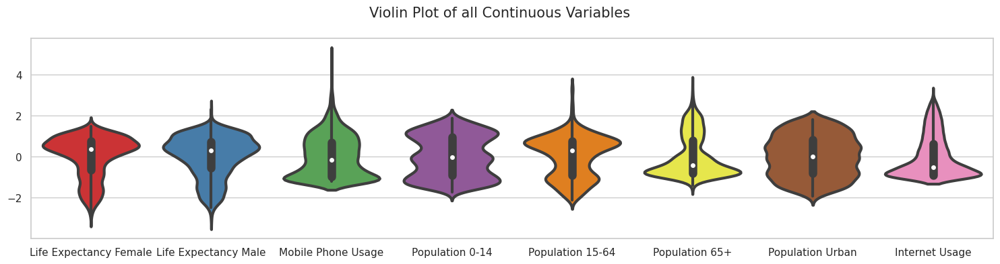

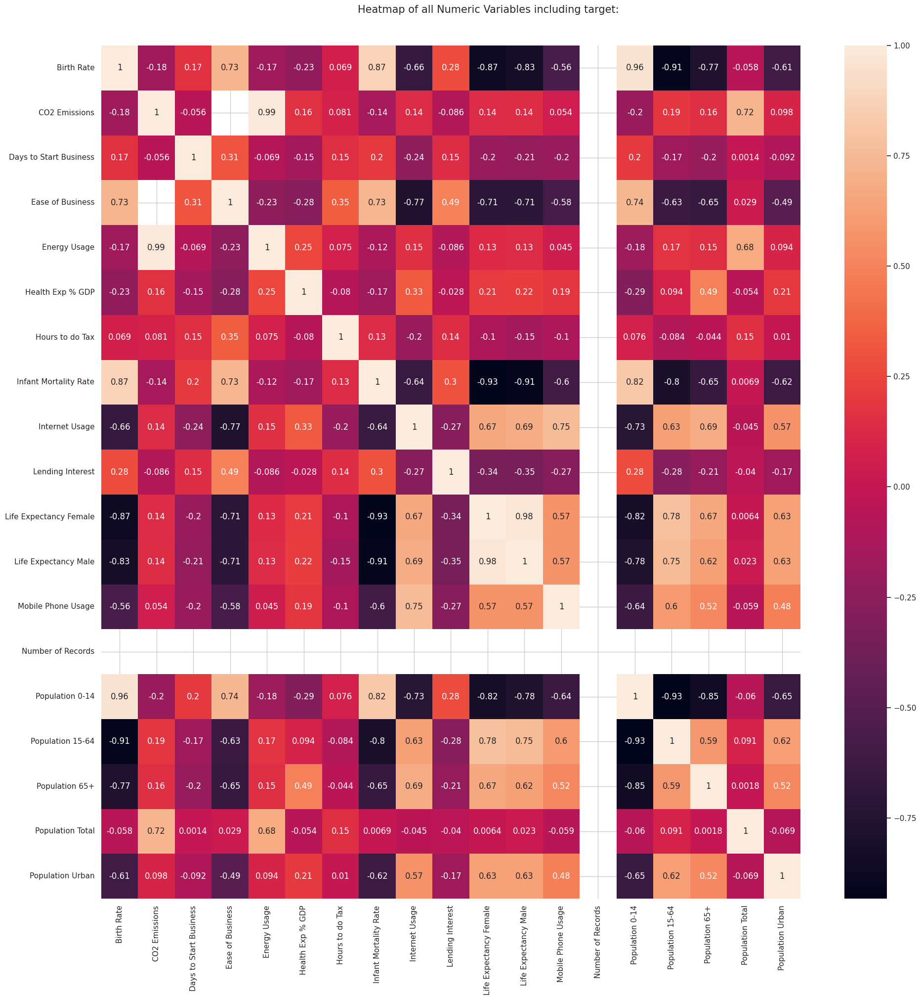

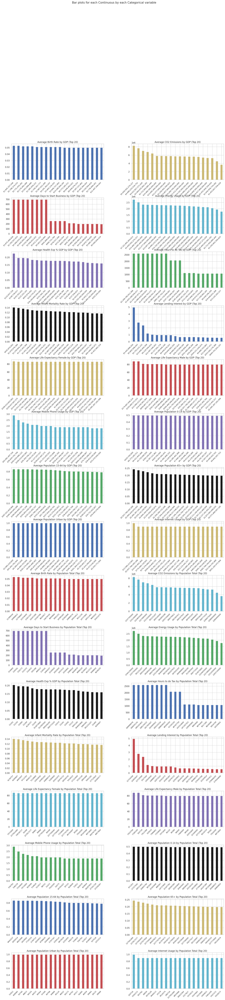

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/cmudict.zip.
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/gazetteers.zip.
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/genesis.zip.
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/gutenberg.zip.
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/inaugural.zip.
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping corpora/movie_reviews.zip.
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/names.zip.
[nltk_data]    | Downloading package shakespeare to /root/nltk_data...
[nlt

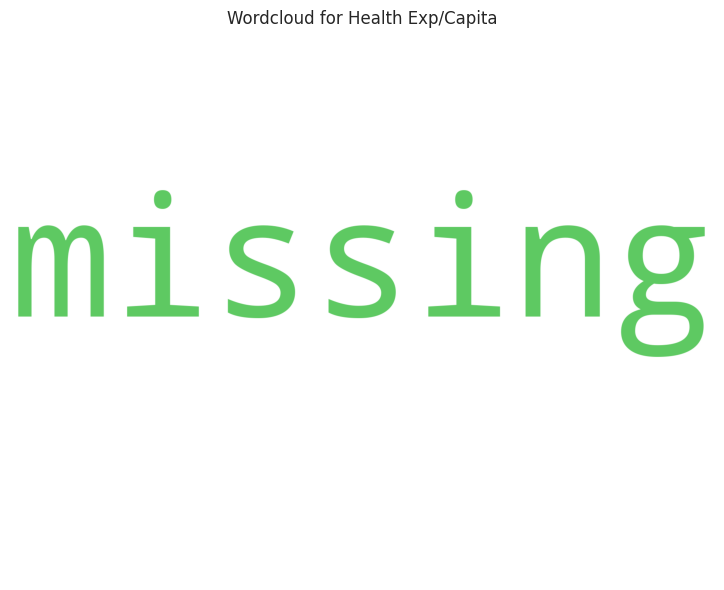

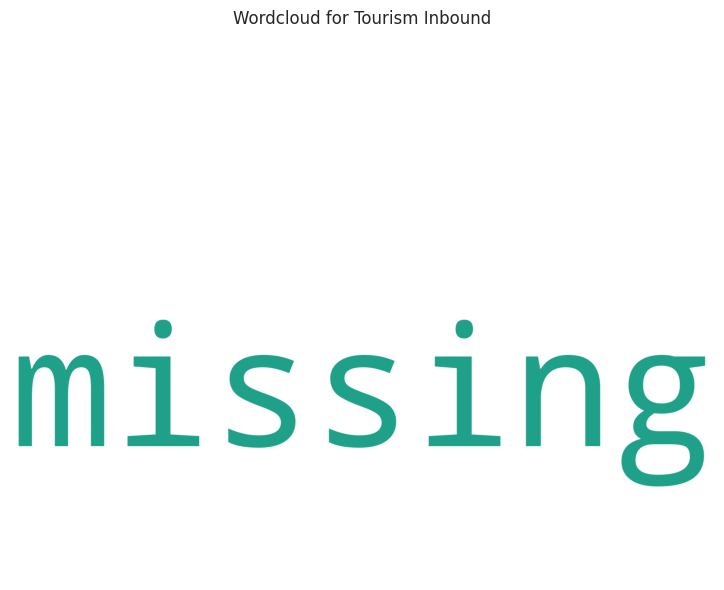

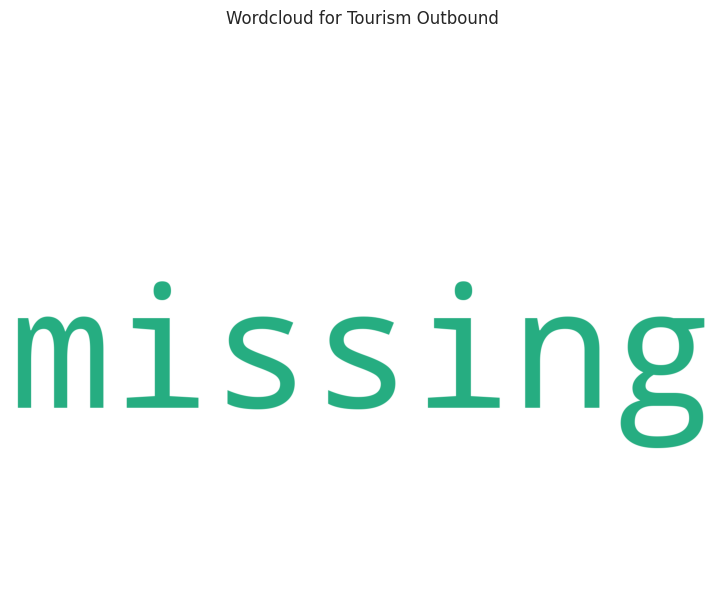

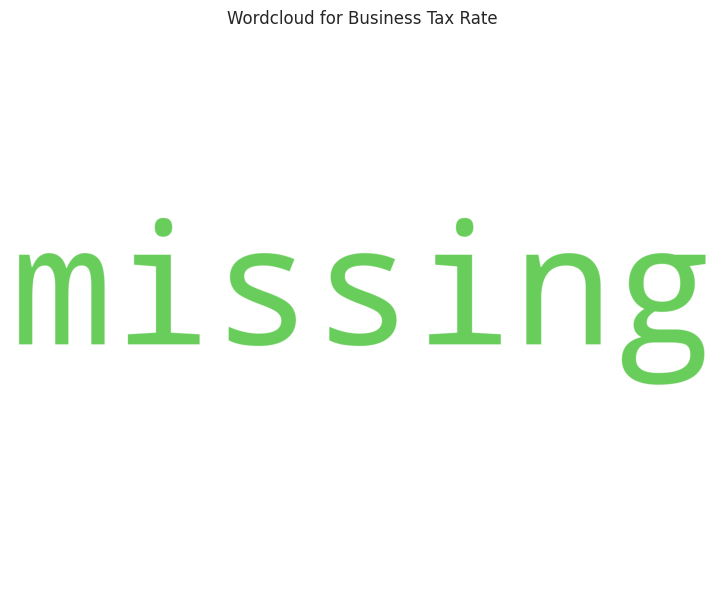

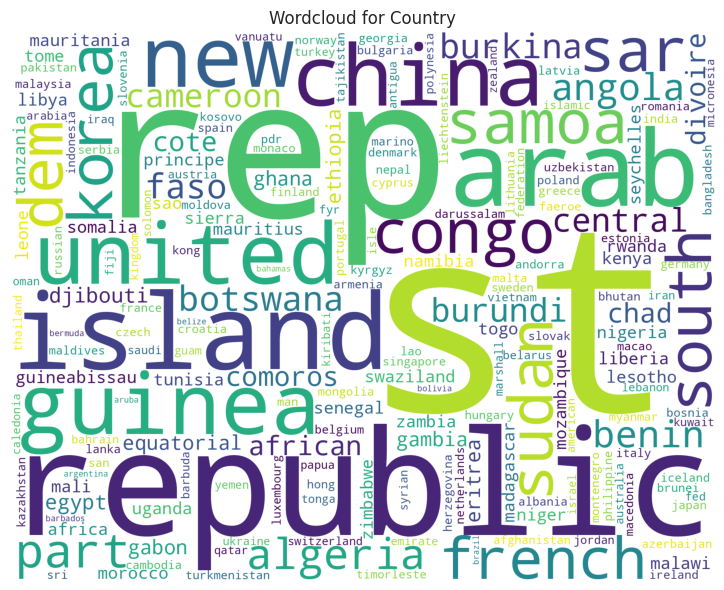

All Plots done
Time to run AutoViz = 124 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


,Birth Rate,Business Tax Rate,CO2 Emissions,Country,Days to Start Business,Ease of Business,Energy Usage,GDP,Health Exp % GDP,Health Exp/Capita,Hours to do Tax,Infant Mortality Rate,Internet Usage,Lending Interest,Life Expectancy Female,Life Expectancy Male,Mobile Phone Usage,Number of Records,Population 0-14,Population 15-64,Population 65+,Population Total,Population Urban,Tourism Inbound,Tourism Outbound
0,0.020,NaN,87931.0,Algeria,NaN,NaN,26998.0,"$54,790,058,957",0.035,$60,NaN,0.034,0.0,0.100,71.0,67.0,0.0,1,0.342,0.619,0.039,31719449,0.599,"$102,000,000","$193,000,000"
1,0.050,NaN,9542.0,Angola,NaN,NaN,7499.0,"$9,129,594,819",0.034,$22,NaN,0.128,0.0,1.032,47.0,44.0,0.0,1,0.476,0.499,0.025,13924930,0.324,"$34,000,000","$146,000,000"
2,0.043,NaN,1617.0,Benin,NaN,NaN,1983.0,"$2,359,122,303",0.043,$15,NaN,0.090,0.0,NaN,57.0,53.0,0.0,1,0.454,0.517,0.029,6949366,0.383,"$77,000,000","$50,000,000"
3,0.027,NaN,4276.0,Botswana,NaN,NaN,1836.0,"$5,788,311,645",0.047,$152,NaN,0.054,0.0,0.155,52.0,49.0,0.1,1,0.383,0.587,0.029,1755375,0.532,"$227,000,000","$209,000,000"
4,0.046,NaN,1041.0,Burkina Faso,NaN,NaN,NaN,"$2,610,959,139",0.051,$12,NaN,0.096,0.0,NaN,52.0,49.0,0.0,1,0.468,0.505,0.028,11607944,0.178,"$23,000,000","$30,000,000"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2699,NaN,NaN,NaN,Turks and Caicos Islands,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,32427,0.911,NaN,NaN
2700,0.013,46.4%,NaN,United States,5.0,4.0,2132446.0,"$16,244,600,000,000",0.179,"$8,895",175.0,0.006,0.8,0.033,81.0,76.0,1.0,1,0.196,0.667,0.136,313873685,0.811,"$200,092,000,000","$126,573,000,000"
2701,0.015,41.9%,NaN,Uruguay,7.0,85.0,NaN,"$50,004,354,667",0.089,"$1,308",310.0,0.010,0.5,0.112,80.0,74.0,1.5,1,0.220,0.639,0.140,3395253,0.948,"$2,222,000,000","$1,028,000,000"
2702,0.020,61.9%,NaN,"Venezuela, RB",144.0,180.0,NaN,"$381,286,223,859",0.046,$593,792.0,0.013,0.5,0.164,78.0,72.0,1.0,1,0.288,0.652,0.060,29954782,0.889,"$904,000,000","$3,202,000,000"


In [104]:
AutoViz_Class().AutoViz('World_development_mesurement (1).xlsx')

In [105]:
df.columns

Index(['BirthRate', 'BusinessTaxRate', 'CO2Emissions', 'DaystoStartBusiness',
       'EnergyUsage', 'GDP', 'HealthExpGDP', 'HealthExpCapita',
       'InfantMortalityRate', 'InternetUsage', 'LifeExpectancyFemale',
       'LifeExpectancyMale', 'MobilePhoneUsage', 'PopulationTotal',
       'PopulationUrban', 'TourismInbound', 'TourismOutbound'],
      dtype='object')

Dimensionality reduction using t-SNE

In [214]:
from sklearn.manifold import TSNE

In [215]:
data_tsne_2 = TSNE(n_components=2,random_state=21).fit_transform(df)

In [216]:
data_tsne_2

array([[ 39.326157 ,   3.4581473],
       [ 14.388823 , -41.759945 ],
       [ 11.41275  ,   5.970186 ],
       ...,
       [ -7.63636  , -21.065638 ],
       [ 36.409763 ,   6.4854794],
       [-54.78425  , -23.599037 ]], dtype=float32)

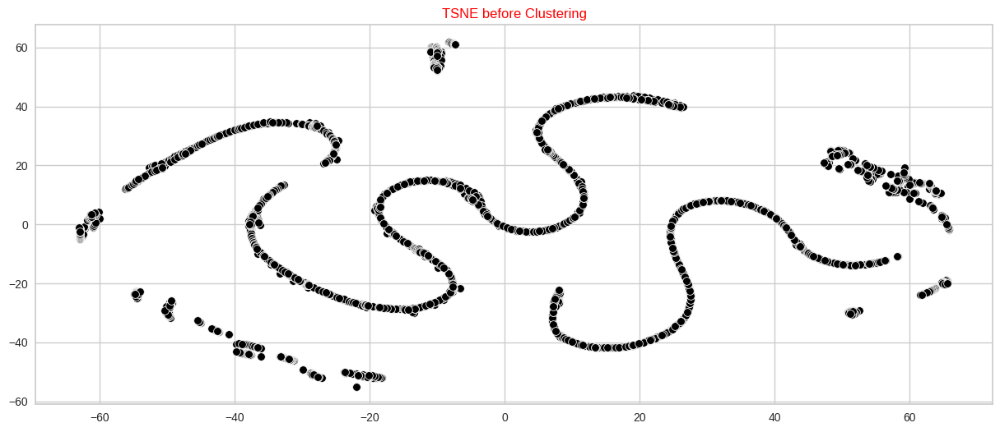

In [217]:
fig=plt.figure(figsize=(15,6))
sns.scatterplot(x=data_tsne_2[:,0],y=data_tsne_2[:,1],color='black')
plt.title('TSNE before Clustering',fontdict={'color':'red'})
plt.show()


# Clustering

KMeans

In [218]:
from sklearn.cluster import KMeans

In [219]:
#kmeans-to get ptimal value of k
wcss=[]
for i in range(1,11):
  kmeans=KMeans(n_clusters=i,random_state=0)
  kmeans.fit(data_tsne_2)
  wcss.append(kmeans.inertia_)

In [220]:
wcss

[5004986.5,
 2716242.5,
 1821389.0,
 1310674.5,
 992036.5625,
 764298.9375,
 661429.125,
 568452.875,
 503259.3125,
 413357.5625]

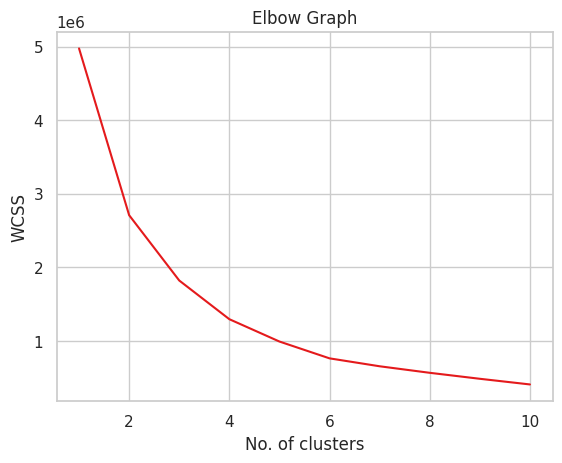

In [113]:
plt.plot(range(1,11),wcss)
plt.title('Elbow Graph')
plt.xlabel('No. of clusters')
plt.ylabel('WCSS')
plt.show()

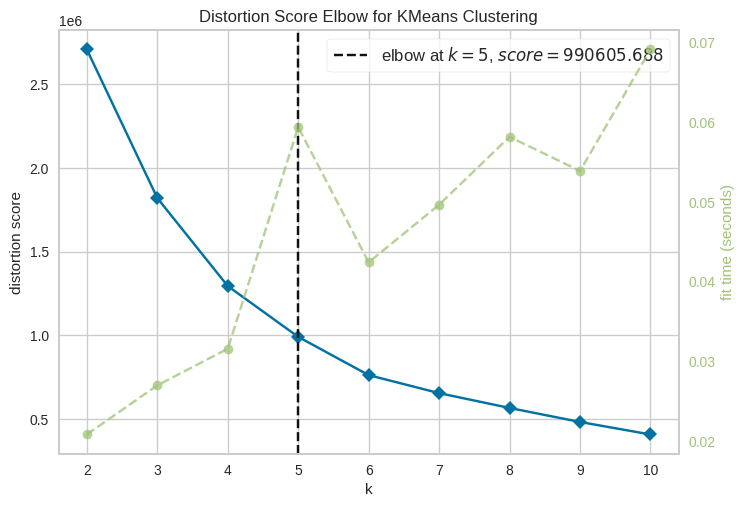

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [114]:
from yellowbrick.cluster import KElbowVisualizer
Elbow_M=KElbowVisualizer(KMeans(),k=10)
Elbow_M.fit(data_tsne_2)
Elbow_M.show()

In [221]:
#Build cluster algorith,
from sklearn.cluster import KMeans
kmeans=KMeans(5,random_state=0)
kmeans.fit(data_tsne_2)

KMeans(n_clusters=5, random_state=0)

In [222]:
k_pred=kmeans.fit_predict(data_tsne_2)
k_pred

array([0, 4, 4, ..., 4, 0, 3], dtype=int32)

In [223]:
kmeans.labels_

array([0, 4, 4, ..., 4, 0, 3], dtype=int32)

In [224]:
centroids=kmeans.cluster_centers_
centroids

array([[ 50.14074  ,   1.7204306],
       [-36.385918 ,  13.784522 ],
       [  5.0119734,  32.289883 ],
       [-31.917282 , -32.58393  ],
       [ 10.887388 , -18.340014 ]], dtype=float32)

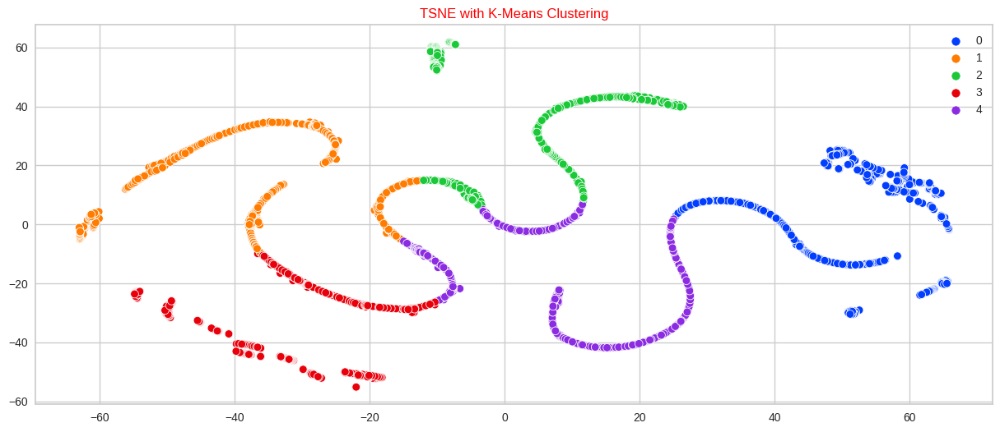

In [225]:
fig=plt.figure(figsize=(15,6))
sns.scatterplot(x=data_tsne_2[:,0], y=data_tsne_2[:,1], hue=kmeans.labels_,palette='bright')
plt.title('TSNE with K-Means Clustering',fontdict={'color':'red'})
fig.savefig('Kmeans2D.jpg')
plt.show()

In [120]:
df["k_clusterid"]=kmeans.labels_

In [121]:
df

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound,k_clusterid
0,0.020,447,87931.0,26.000,26998.000,1696,0.035,58,0.0340,0.0,71.0,67.0,0.0,3.171945e+07,0.599,185,245,3
1,0.050,447,9542.0,26.000,7499.000,1016,0.034,20,0.1075,0.0,47.0,44.0,0.0,1.392493e+07,0.324,110,206,4
2,0.043,447,1617.0,26.000,1983.000,498,0.043,13,0.0900,0.0,57.0,53.0,0.0,6.949366e+06,0.383,161,115,4
3,0.027,447,4276.0,26.000,1836.000,816,0.047,147,0.0540,0.0,52.0,49.0,0.1,1.755375e+06,0.532,281,260,2
4,0.046,447,1041.0,26.000,14338.000,529,0.051,10,0.0960,0.0,52.0,49.0,0.0,1.160794e+07,0.178,95,89,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2699,0.020,447,8529.0,26.000,14338.000,2494,0.061,626,0.0200,0.1,75.0,69.0,0.5,3.242700e+04,0.911,1650,1457,0
2700,0.013,241,8529.0,5.000,46913.625,2493,0.118,626,0.0060,0.8,81.0,76.0,1.0,4.903473e+07,0.811,1649,1456,3
2701,0.015,200,8529.0,7.000,14338.000,1670,0.089,626,0.0100,0.5,80.0,74.0,1.5,3.395253e+06,0.948,927,683,1
2702,0.020,346,8529.0,55.625,14338.000,2218,0.046,478,0.0130,0.5,78.0,72.0,1.0,2.995478e+07,0.889,644,938,3


In [122]:
df_profile_overall=df.describe().T

In [123]:
df_profile_overall

,count,mean,std,min,25%,50%,75%,max
BirthRate,2704.0,2.259541e-02,1.110001e-02,0.007,0.01300,0.020,3.000000e-02,5.300000e-02
BusinessTaxRate,2704.0,3.190466e+02,1.483404e+02,0.000,187.00000,411.500,4.470000e+02,4.470000e+02
CO2Emissions,2704.0,2.730082e+04,3.653684e+04,7.000,2237.00000,8529.000,4.256200e+04,1.030495e+05
DaystoStartBusiness,2704.0,2.813998e+01,1.416760e+01,1.000,20.00000,26.000,3.425000e+01,5.562500e+01
EnergyUsage,2704.0,1.826808e+04,1.477494e+04,8.000,7851.75000,14338.000,2.347650e+04,4.691362e+04
GDP,2704.0,1.343384e+03,7.679684e+02,0.000,675.75000,1351.500,2.027250e+03,2.494000e+03
HealthExpGDP,2704.0,6.302996e-02,2.213957e-02,0.008,0.04800,0.061,7.600000e-02,1.180000e-01
HealthExpCapita,2704.0,3.088850e+02,2.491856e+02,0.000,56.00000,248.500,6.260000e+02,6.260000e+02
InfantMortalityRate,2704.0,3.140440e-02,2.821458e-02,0.002,0.01000,0.020,4.900000e-02,1.075000e-01
InternetUsage,2704.0,2.308062e-01,2.539833e-01,0.000,0.00000,0.100,4.000000e-01,1.000000e+00


In [124]:
df_profile_overall['Overall Dataset'] = df_profile_overall[['mean']]
df_profile_overall = df_profile_overall[['Overall Dataset']]

In [125]:
df_profile_overall

,Overall Dataset
BirthRate,2.259541e-02
BusinessTaxRate,3.190466e+02
CO2Emissions,2.730082e+04
DaystoStartBusiness,2.813998e+01
EnergyUsage,1.826808e+04
GDP,1.343384e+03
HealthExpGDP,6.302996e-02
HealthExpCapita,3.088850e+02
InfantMortalityRate,3.140440e-02
InternetUsage,2.308062e-01


In [126]:
df_cluster_summary = df.groupby('k_clusterid').describe().T.reset_index()
df_cluster_summary = df_cluster_summary.rename(columns={'level_0':'column','level_1':'metric'})
df_cluster_summary


k_clusterid,column,metric,0,1,2,3,4
0,BirthRate,count,4.880000e+02,5.490000e+02,5.960000e+02,5.630000e+02,5.080000e+02
1,BirthRate,mean,2.167213e-02,1.925683e-02,2.187584e-02,2.152931e-02,2.911614e-02
2,BirthRate,std,1.225177e-02,7.878038e-03,9.909406e-03,1.058420e-02,1.219954e-02
3,BirthRate,min,9.000000e-03,8.000000e-03,8.000000e-03,8.000000e-03,7.000000e-03
4,BirthRate,25%,1.100000e-02,1.300000e-02,1.400000e-02,1.300000e-02,1.900000e-02
5,BirthRate,50%,2.000000e-02,1.900000e-02,1.900000e-02,2.000000e-02,2.900000e-02
6,BirthRate,75%,3.000000e-02,2.200000e-02,2.925000e-02,2.500000e-02,3.900000e-02
7,BirthRate,max,5.100000e-02,4.300000e-02,4.500000e-02,4.800000e-02,5.300000e-02
8,BusinessTaxRate,count,4.880000e+02,5.490000e+02,5.960000e+02,5.630000e+02,5.080000e+02
9,BusinessTaxRate,mean,3.547500e+02,3.260291e+02,2.997903e+02,3.139805e+02,3.054094e+02


In [127]:
df_cluster_summary = df_cluster_summary[df_cluster_summary['metric'] == "mean"]
df_cluster_summary = df_cluster_summary.set_index('column')

In [128]:
df_cluster_summary

k_clusterid,metric,0,1,2,3,4
column,,,,,,
BirthRate,mean,2.167213e-02,1.925683e-02,2.187584e-02,2.152931e-02,2.911614e-02
BusinessTaxRate,mean,3.547500e+02,3.260291e+02,2.997903e+02,3.139805e+02,3.054094e+02
CO2Emissions,mean,2.466920e+04,8.647077e+03,8.560093e+03,6.718122e+04,2.777710e+04
DaystoStartBusiness,mean,2.624949e+01,2.652436e+01,2.896518e+01,2.841896e+01,3.042470e+01
EnergyUsage,mean,1.750345e+04,1.014175e+04,1.001558e+04,3.687898e+04,1.684102e+04
GDP,mean,1.496676e+03,9.401111e+02,9.412785e+02,2.002442e+03,1.373297e+03
HealthExpGDP,mean,6.801434e-02,6.410018e-02,6.074329e-02,6.145115e-02,6.151772e-02
HealthExpCapita,mean,3.615184e+02,3.687923e+02,3.504614e+02,2.556288e+02,2.038248e+02
InfantMortalityRate,mean,3.092828e-02,2.440984e-02,2.800252e-02,3.052664e-02,4.438484e-02


In [129]:
mean_sorted_kmeans=df.groupby(df["k_clusterid"]).agg(["mean"])
for col in mean_sorted_kmeans.columns:
  mean_sorted_kmeans=mean_sorted_kmeans.sort_values(by=col,ascending=True)
display(mean_sorted_kmeans)

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound
,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean
k_clusterid,,,,,,,,,,,,,,,,,
2,0.021876,299.790268,8560.093121,28.965185,10015.583893,941.278523,0.060743,350.461409,0.028003,0.248826,72.204698,67.708054,0.611493,1.339240e+06,0.572480,687.406040,561.741611
1,0.019257,326.029144,8647.077413,26.524362,10141.750455,940.111111,0.064100,368.792350,0.024410,0.249180,73.043716,67.728597,0.627049,1.635858e+06,0.598064,666.386157,607.526412
4,0.029116,305.409449,27777.099409,30.424705,16841.022146,1373.297244,0.061518,203.824803,0.044385,0.124016,66.901575,62.954724,0.438780,1.457494e+07,0.482870,672.931102,650.913386
0,0.021672,354.750000,24669.195697,26.249488,17503.454918,1496.676230,0.068014,361.518443,0.030928,0.290984,72.350410,67.303279,0.616701,6.735545e+06,0.597152,926.084016,801.793033
3,0.021529,313.980462,67181.224689,28.418961,36878.976465,2002.442274,0.061451,255.628774,0.030527,0.238011,72.005329,67.001776,0.559503,4.317731e+07,0.561108,1037.964476,949.845471


<Axes: xlabel='k_clusterid', ylabel='count'>

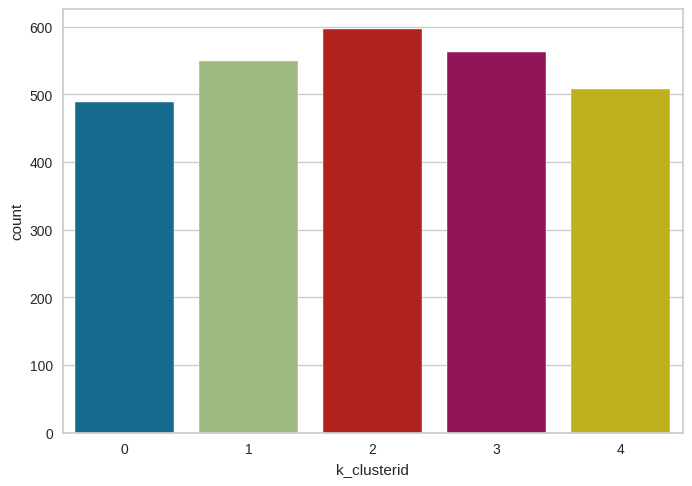

In [130]:
sns.countplot(x="k_clusterid", data=df)

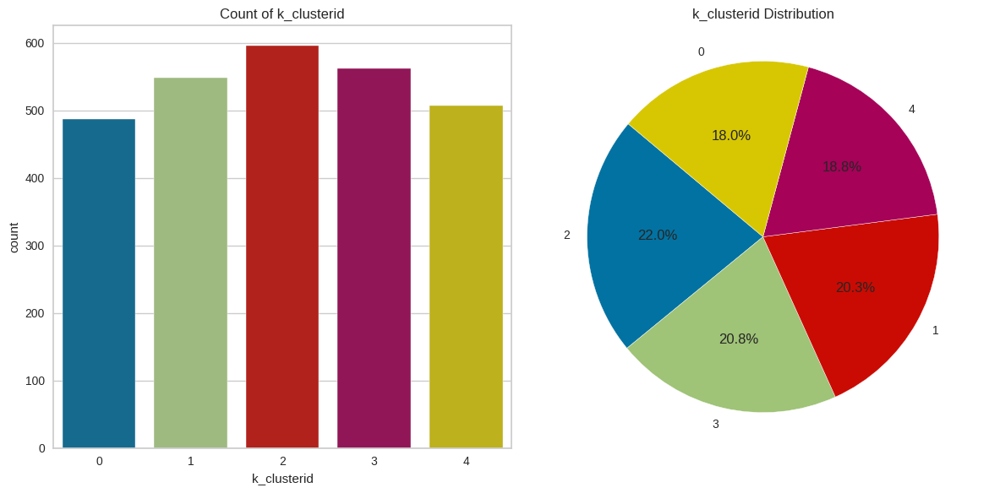

In [131]:

cluster_column = 'k_clusterid'

num_clusters = len(df[cluster_column].unique())

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

sns.countplot(data=df, x=cluster_column, ax=axes[0])
axes[0].set_title(f'Count of {cluster_column}')

cluster_counts = df[cluster_column].value_counts()
axes[1].pie(cluster_counts, labels=cluster_counts.index, autopct='%1.1f%%', startangle=140)
axes[1].axis('equal')
axes[1].set_title(f'{cluster_column} Distribution')

plt.tight_layout()
plt.show()

In [132]:
import numpy as np
correlation_matrix = np.corrcoef(df.drop('k_clusterid', axis=1), rowvar=False)
print(correlation_matrix)


[[ 1.          0.03933375 -0.35173067  0.26339422 -0.28302196 -0.41935079
  -0.23826811 -0.66137807  0.87015892 -0.62461702 -0.86521022 -0.82241646
  -0.53891575  0.01278108 -0.59235978 -0.38353048 -0.28941639]
 [ 0.03933375  1.          0.02273015  0.08166877  0.01069303 -0.02355206
  -0.0927251  -0.02892627  0.1344944  -0.25594803 -0.06290643 -0.09449878
  -0.4307413  -0.01217331  0.03736803  0.01177602  0.06800098]
 [-0.35173067  0.02273015  1.         -0.0724689   0.83402996  0.58525513
   0.05686176  0.17809116 -0.29901478  0.18893374  0.31225386  0.29587026
   0.14288644  0.62908529  0.2981779   0.36635699  0.39316407]
 [ 0.26339422  0.08166877 -0.0724689   1.         -0.15477368 -0.1711536
  -0.22533989 -0.29456738  0.26089274 -0.38813942 -0.30196325 -0.31234001
  -0.31726774  0.0117807  -0.23086679 -0.20084583 -0.14268898]
 [-0.28302196  0.01069303  0.83402996 -0.15477368  1.          0.60107105
   0.1066094   0.21400812 -0.22424128  0.28211408  0.25649513  0.25066926
   0.1953

In [133]:
cluster_profiles = df.groupby('k_clusterid').mean()
print("Cluster Profiles:")
print(cluster_profiles)


Cluster Profiles:
             BirthRate  BusinessTaxRate  CO2Emissions  DaystoStartBusiness  \
k_clusterid                                                                  
0            0.021672     354.750000     24669.195697       26.249488        
1            0.019257     326.029144      8647.077413       26.524362        
2            0.021876     299.790268      8560.093121       28.965185        
3            0.021529     313.980462     67181.224689       28.418961        
4            0.029116     305.409449     27777.099409       30.424705        

              EnergyUsage      GDP      HealthExpGDP  HealthExpCapita  \
k_clusterid                                                             
0            17503.454918  1496.676230    0.068014      361.518443      
1            10141.750455   940.111111    0.064100      368.792350      
2            10015.583893   941.278523    0.060743      350.461409      
3            36878.976465  2002.442274    0.061451      255.628774    

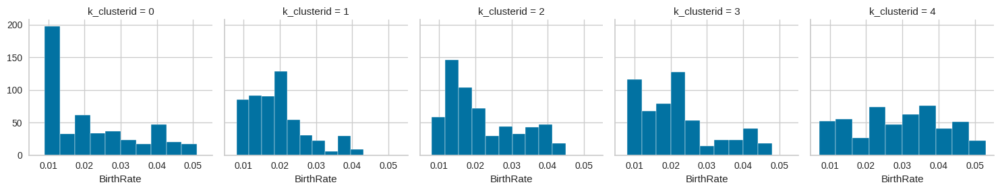

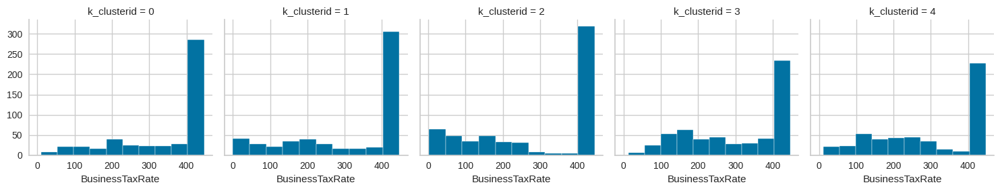

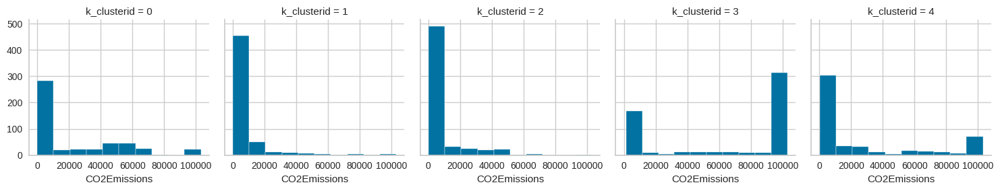

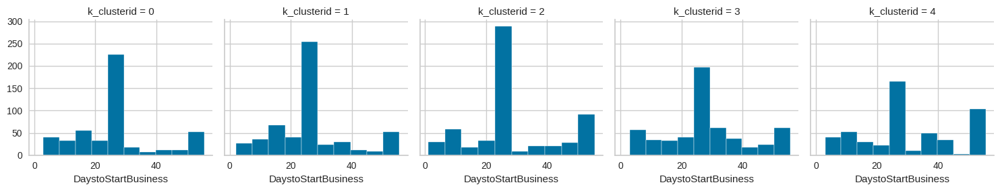

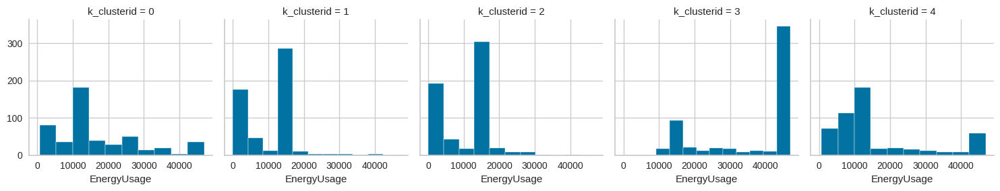

...

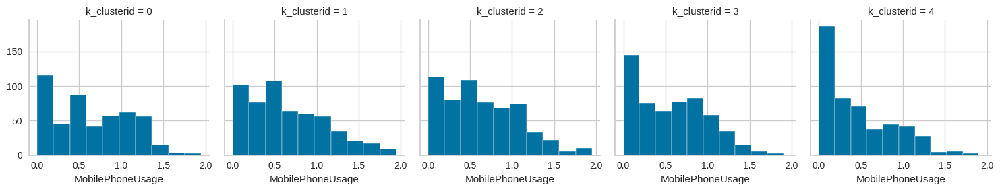

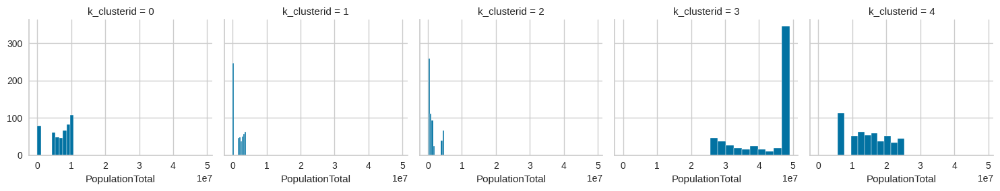

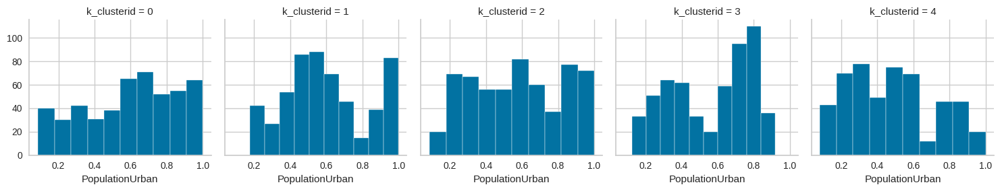

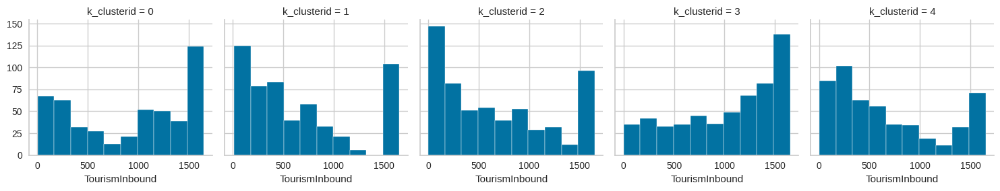

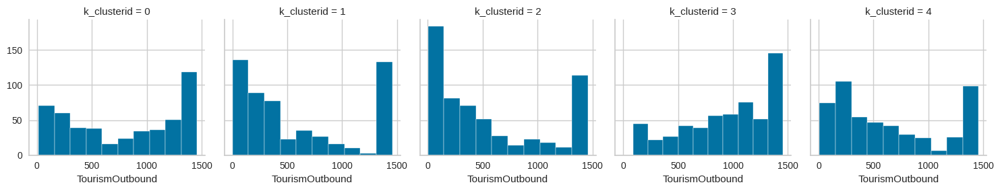

In [134]:
for c in df.drop(['k_clusterid'],axis=1):
    grid= sns.FacetGrid(df, col='k_clusterid')
    grid= grid.map(plt.hist, c)
plt.show()

In [135]:
df.columns

Index(['BirthRate', 'BusinessTaxRate', 'CO2Emissions', 'DaystoStartBusiness',
       'EnergyUsage', 'GDP', 'HealthExpGDP', 'HealthExpCapita',
       'InfantMortalityRate', 'InternetUsage', 'LifeExpectancyFemale',
       'LifeExpectancyMale', 'MobilePhoneUsage', 'PopulationTotal',
       'PopulationUrban', 'TourismInbound', 'TourismOutbound', 'k_clusterid'],
      dtype='object')

In [136]:
df_sorted = df.sort_values(by='k_clusterid')
df_sorted

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound,k_clusterid
2122,0.045,447,609.0,26.000,14338.0,2494,0.061,626,0.0970,0.1,56.0,52.0,0.1,9636173.0,0.373,1650,1457,0
453,0.040,447,689.0,26.000,14338.0,411,0.042,6,0.0920,0.0,51.0,50.0,0.0,8987523.0,0.168,107,78,0
2487,0.017,447,8529.0,26.000,14338.0,2494,0.061,626,0.0200,0.1,82.0,76.0,0.5,30615.0,0.560,1650,1457,0
2276,0.020,447,8529.0,26.000,14338.0,2494,0.061,626,0.0200,0.1,75.0,69.0,0.5,37850.0,1.000,552,167,0
1394,0.016,12,103049.5,19.000,45911.0,2080,0.023,626,0.0080,0.5,77.0,75.0,1.1,4875639.0,0.826,1160,1168,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1046,0.040,280,3696.0,45.000,6981.0,1282,0.049,43,0.0780,0.0,53.0,51.0,0.1,18137734.0,0.485,282,454,4
1044,0.045,252,1126.0,40.000,14338.0,784,0.069,26,0.0860,0.0,53.0,52.0,0.0,13421929.0,0.215,127,140,4
1041,0.049,292,19156.0,55.625,9356.0,1489,0.042,69,0.1075,0.0,50.0,47.0,0.1,16544376.0,0.362,186,195,4
1067,0.038,246,1742.0,38.000,14338.0,755,0.049,11,0.0550,0.0,63.0,60.0,0.0,18290394.0,0.288,331,145,4


In [137]:
#separating datapoints for each of the clusters
clusters = df_sorted['k_clusterid'].unique()
clusters

array([0, 1, 2, 3, 4], dtype=int32)

In [138]:
Cluster0 = df_sorted[df_sorted['k_clusterid'] == 0 ]

In [139]:
Cluster0

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound,k_clusterid
2122,0.045,447,609.0,26.000,14338.000,2494,0.061,626,0.0970,0.1,56.0,52.0,0.10,9636173.0,0.373,1650,1457,0
453,0.040,447,689.0,26.000,14338.000,411,0.042,6,0.0920,0.0,51.0,50.0,0.00,8987523.0,0.168,107,78,0
2487,0.017,447,8529.0,26.000,14338.000,2494,0.061,626,0.0200,0.1,82.0,76.0,0.50,30615.0,0.560,1650,1457,0
2276,0.020,447,8529.0,26.000,14338.000,2494,0.061,626,0.0200,0.1,75.0,69.0,0.50,37850.0,1.000,552,167,0
1394,0.016,12,103049.5,19.000,45911.000,2080,0.023,626,0.0080,0.5,77.0,75.0,1.10,4875639.0,0.826,1160,1168,0
901,0.022,447,5699.0,21.000,2542.000,486,0.056,23,0.0360,0.1,72.0,64.0,0.10,5104700.0,0.353,175,139,0
2491,0.020,447,8529.0,26.000,14338.000,2494,0.061,626,0.0200,0.1,75.0,69.0,0.50,31726.0,0.907,1650,1457,0
2268,0.027,221,8108.0,14.000,4567.000,1261,0.087,168,0.0210,0.1,75.0,70.0,1.20,7621204.0,0.517,516,404,0
442,0.023,447,47832.0,26.000,16951.000,1353,0.049,177,0.0230,0.0,74.0,71.0,0.00,5340389.0,0.765,264,542,0
2267,0.027,187,2120.0,55.625,2409.000,879,0.067,43,0.0730,0.1,64.0,60.0,0.40,9896400.0,0.520,242,421,0


In [140]:
Cluster1 = df_sorted[df_sorted['k_clusterid'] == 1]

In [141]:
Cluster2 = df_sorted[df_sorted['k_clusterid'] == 2 ]

In [142]:
Cluster3 = df_sorted[df_sorted['k_clusterid'] == 3 ]

In [143]:
Cluster4 = df_sorted[df_sorted['k_clusterid'] == 4]

In [144]:
df_frame = {'column_names': ['BirthRate','BusinessTaxRate','CO2Emissions','DaystoStartBusiness','EnergyUsage','GDP','HealthExpGDP','HealthExpCapita','InfantMortalityRate','InternetUsage','LifeExpectancyFemale','LifeExpectancyMale','MobilePhoneUsage','PopulationTotal','PopulationUrban','TourismInbound','TourismOutbound'],
         'cluster0': [Cluster0['BirthRate'].mean(), Cluster0['BusinessTaxRate'].mean(), Cluster0['CO2Emissions'].mean(), Cluster0['DaystoStartBusiness'].mean(),
                      Cluster0['EnergyUsage'].mean(),Cluster0['GDP'].mean(),Cluster0['HealthExpGDP'].mean(),Cluster0['HealthExpCapita'].mean(),
                      Cluster0['InfantMortalityRate'].mean(),Cluster0['InternetUsage'].mean(),Cluster0['LifeExpectancyFemale'].mean(),
                      Cluster0['LifeExpectancyMale'].mean(),Cluster0['MobilePhoneUsage'].mean(),Cluster0['PopulationTotal'].mean(),Cluster0['PopulationUrban'].mean(),
                      Cluster0['TourismInbound'].mean(),Cluster0['TourismOutbound'].mean()],
         'cluster1': [Cluster1['BirthRate'].mean(), Cluster1['BusinessTaxRate'].mean(), Cluster1['CO2Emissions'].mean(), Cluster1['DaystoStartBusiness'].mean(),
                      Cluster1['EnergyUsage'].mean(),Cluster1['GDP'].mean(),Cluster1['HealthExpGDP'].mean(),Cluster1['HealthExpCapita'].mean(),
                      Cluster1['InfantMortalityRate'].mean(),Cluster1['InternetUsage'].mean(),Cluster1['LifeExpectancyFemale'].mean(),
                      Cluster1['LifeExpectancyMale'].mean(),Cluster1['MobilePhoneUsage'].mean(),Cluster1['PopulationTotal'].mean(),Cluster1['PopulationUrban'].mean(),
                      Cluster1['TourismInbound'].mean(),Cluster1['TourismOutbound'].mean()],
         'cluster2': [Cluster2['BirthRate'].mean(), Cluster2['BusinessTaxRate'].mean(), Cluster2['CO2Emissions'].mean(), Cluster2['DaystoStartBusiness'].mean(),
                      Cluster2['EnergyUsage'].mean(),Cluster2['GDP'].mean(),Cluster2['HealthExpGDP'].mean(),Cluster2['HealthExpCapita'].mean(),
                      Cluster2['InfantMortalityRate'].mean(),Cluster2['InternetUsage'].mean(),Cluster2['LifeExpectancyFemale'].mean(),
                      Cluster2['LifeExpectancyMale'].mean(),Cluster2['MobilePhoneUsage'].mean(),Cluster2['PopulationTotal'].mean(),Cluster2['PopulationUrban'].mean(),
                      Cluster2['TourismInbound'].mean(),Cluster2['TourismOutbound'].mean()],
         'cluster3': [Cluster3['BirthRate'].mean(), Cluster3['BusinessTaxRate'].mean(), Cluster3['CO2Emissions'].mean(), Cluster3['DaystoStartBusiness'].mean(),
                      Cluster3['EnergyUsage'].mean(),Cluster3['GDP'].mean(),Cluster3['HealthExpGDP'].mean(),Cluster3['HealthExpCapita'].mean(),
                      Cluster3['InfantMortalityRate'].mean(),Cluster3['InternetUsage'].mean(),Cluster3['LifeExpectancyFemale'].mean(),
                      Cluster3['LifeExpectancyMale'].mean(),Cluster3['MobilePhoneUsage'].mean(),Cluster3['PopulationTotal'].mean(),Cluster3['PopulationUrban'].mean(),
                      Cluster3['TourismInbound'].mean(),Cluster3['TourismOutbound'].mean()],
          'cluster4':[Cluster4['BirthRate'].mean(), Cluster4['BusinessTaxRate'].mean(), Cluster4['CO2Emissions'].mean(), Cluster4['DaystoStartBusiness'].mean(),
                      Cluster4['EnergyUsage'].mean(),Cluster4['GDP'].mean(),Cluster4['HealthExpGDP'].mean(),Cluster4['HealthExpCapita'].mean(),
                      Cluster4['InfantMortalityRate'].mean(),Cluster4['InternetUsage'].mean(),Cluster4['LifeExpectancyFemale'].mean(),
                      Cluster4['LifeExpectancyMale'].mean(),Cluster4['MobilePhoneUsage'].mean(),Cluster4['PopulationTotal'].mean(),Cluster4['PopulationUrban'].mean(),
                      Cluster4['TourismInbound'].mean(),Cluster4['TourismOutbound'].mean()] }
df_hp = pd.DataFrame(df_frame)

In [145]:
df_hp

,column_names,cluster0,cluster1,cluster2,cluster3,cluster4
0,BirthRate,2.167213e-02,1.925683e-02,2.187584e-02,2.152931e-02,2.911614e-02
1,BusinessTaxRate,3.547500e+02,3.260291e+02,2.997903e+02,3.139805e+02,3.054094e+02
2,CO2Emissions,2.466920e+04,8.647077e+03,8.560093e+03,6.718122e+04,2.777710e+04
3,DaystoStartBusiness,2.624949e+01,2.652436e+01,2.896518e+01,2.841896e+01,3.042470e+01
4,EnergyUsage,1.750345e+04,1.014175e+04,1.001558e+04,3.687898e+04,1.684102e+04
5,GDP,1.496676e+03,9.401111e+02,9.412785e+02,2.002442e+03,1.373297e+03
6,HealthExpGDP,6.801434e-02,6.410018e-02,6.074329e-02,6.145115e-02,6.151772e-02
7,HealthExpCapita,3.615184e+02,3.687923e+02,3.504614e+02,2.556288e+02,2.038248e+02
8,InfantMortalityRate,3.092828e-02,2.440984e-02,2.800252e-02,3.052664e-02,4.438484e-02
9,InternetUsage,2.909836e-01,2.491803e-01,2.488255e-01,2.380107e-01,1.240157e-01


In [146]:
df_hp_copy=df_hp.copy()

In [147]:
df_hp_copy=df_hp_copy.drop(columns=["column_names"])

In [148]:
# Save the DataFrame to a CSV file
csv_filename = 'sort_data.csv'
df_hp_copy.to_csv(csv_filename, index=False)

In [149]:
df.columns

Index(['BirthRate', 'BusinessTaxRate', 'CO2Emissions', 'DaystoStartBusiness',
       'EnergyUsage', 'GDP', 'HealthExpGDP', 'HealthExpCapita',
       'InfantMortalityRate', 'InternetUsage', 'LifeExpectancyFemale',
       'LifeExpectancyMale', 'MobilePhoneUsage', 'PopulationTotal',
       'PopulationUrban', 'TourismInbound', 'TourismOutbound', 'k_clusterid'],
      dtype='object')

Generating Insights

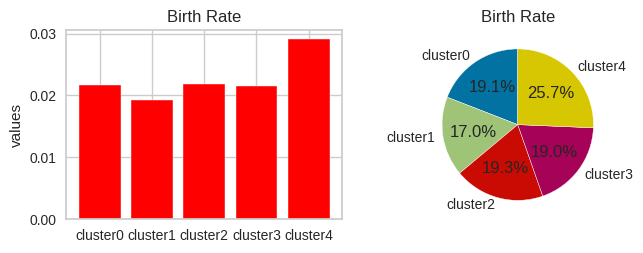

In [150]:
BirthRate =df_hp_copy.iloc[0]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns, BirthRate, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("Birth Rate")

axes[1].pie(BirthRate, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("Birth Rate")

plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

plt.show()

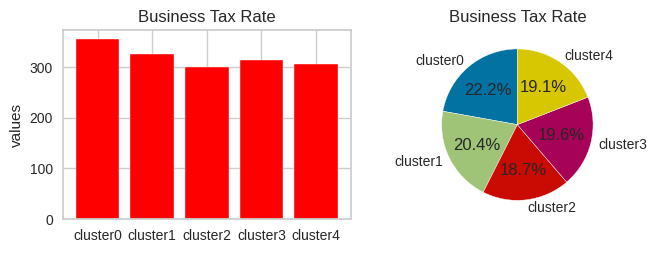

In [151]:
BusinessTaxRate =df_hp_copy.iloc[1]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns, BusinessTaxRate, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("Business Tax Rate")

axes[1].pie(BusinessTaxRate, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("Business Tax Rate")

plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

plt.show()

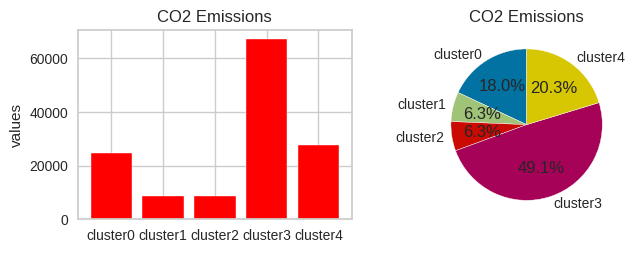

In [152]:
CO2Emissions =df_hp_copy.iloc[2]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,CO2Emissions, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("CO2 Emissions")

axes[1].pie(CO2Emissions, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("CO2 Emissions")

plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

plt.show()

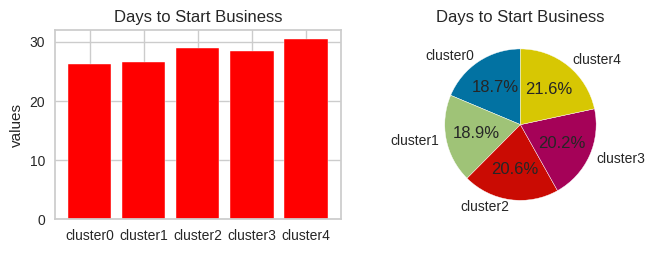

In [153]:
DaystoStartBusiness =df_hp_copy.iloc[3]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns, DaystoStartBusiness, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("Days to Start Business")

axes[1].pie(DaystoStartBusiness, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("Days to Start Business")

plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

plt.show()

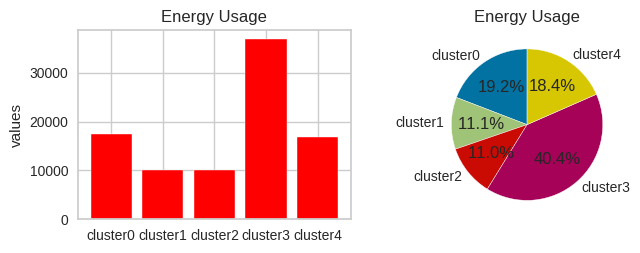

In [154]:
EnergyUsage =df_hp_copy.iloc[4]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns, EnergyUsage, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("Energy Usage")

axes[1].pie(EnergyUsage, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("Energy Usage")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

plt.show()

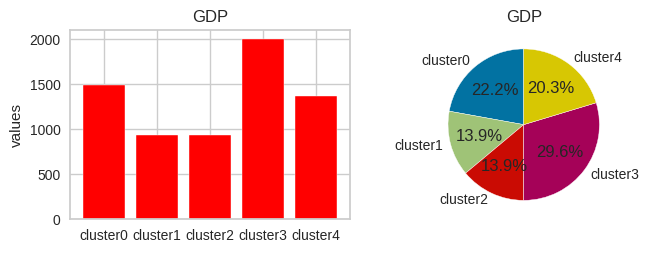

In [155]:
GDP =df_hp_copy.iloc[5]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,GDP, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("GDP")

axes[1].pie(GDP, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("GDP")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))


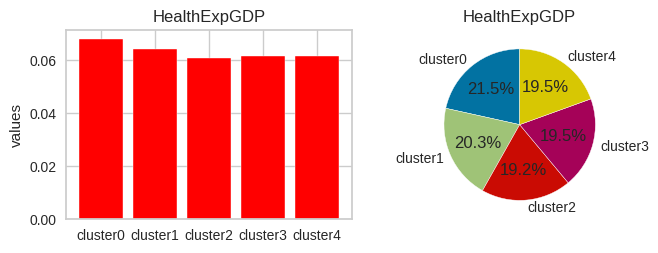

In [156]:
HealthExpGDP =df_hp_copy.iloc[6]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,HealthExpGDP, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("HealthExpGDP")

axes[1].pie(HealthExpGDP, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("HealthExpGDP")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

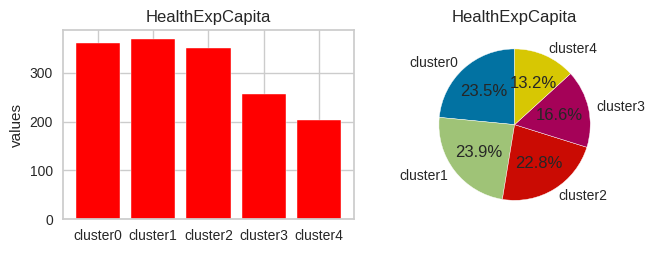

In [157]:
HealthExpCapita =df_hp_copy.iloc[7]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,HealthExpCapita, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("HealthExpCapita")

axes[1].pie(HealthExpCapita, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("HealthExpCapita")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

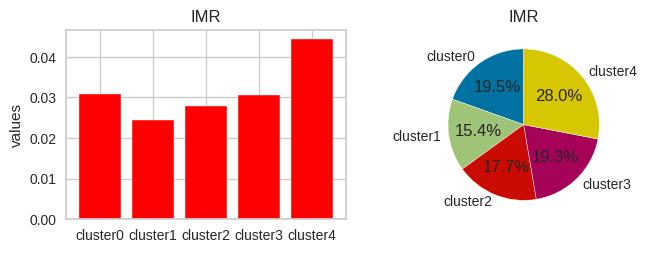

In [158]:
InfantMortalityRate =df_hp_copy.iloc[8]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,InfantMortalityRate, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("IMR")

axes[1].pie(InfantMortalityRate, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("IMR")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

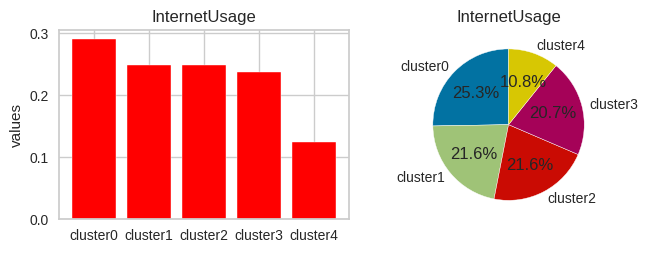

In [159]:
InternetUsage =df_hp_copy.iloc[9]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,InternetUsage, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("InternetUsage")

axes[1].pie(InternetUsage, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("InternetUsage")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

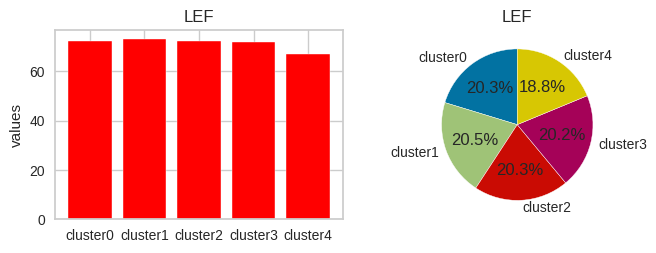

In [160]:
LifeExpectancyFemale =df_hp_copy.iloc[10]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,LifeExpectancyFemale, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("LEF")

axes[1].pie(LifeExpectancyFemale, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("LEF")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

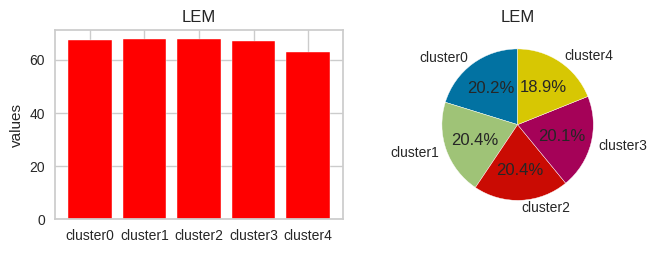

In [161]:
LifeExpectancyMale =df_hp_copy.iloc[11]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,LifeExpectancyMale, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("LEM")

axes[1].pie(LifeExpectancyMale, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("LEM")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

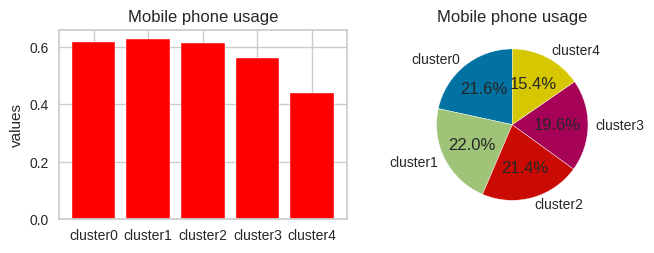

In [162]:
MobilePhoneUsage =df_hp_copy.iloc[12]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,MobilePhoneUsage, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("Mobile phone usage")

axes[1].pie(MobilePhoneUsage, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("Mobile phone usage")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

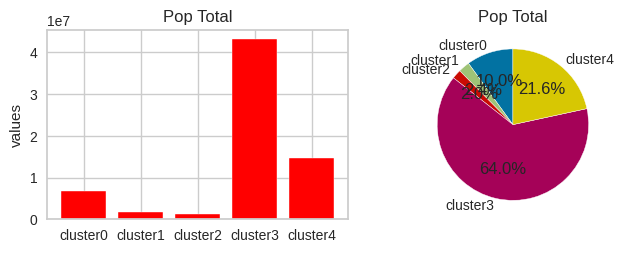

In [163]:
PopulationTotal =df_hp_copy.iloc[13]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,PopulationTotal, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("Pop Total")

axes[1].pie(PopulationTotal, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("Pop Total")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

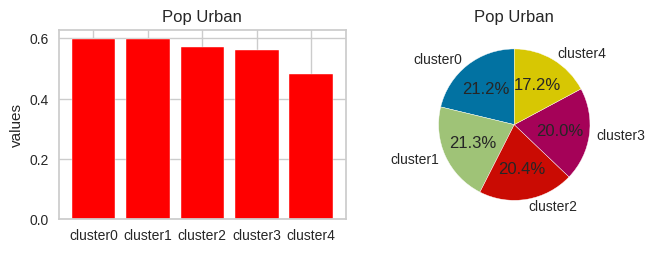

In [164]:
PopulationUrban =df_hp_copy.iloc[14]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,PopulationUrban, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("Pop Urban")

axes[1].pie(PopulationUrban, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("Pop Urban")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

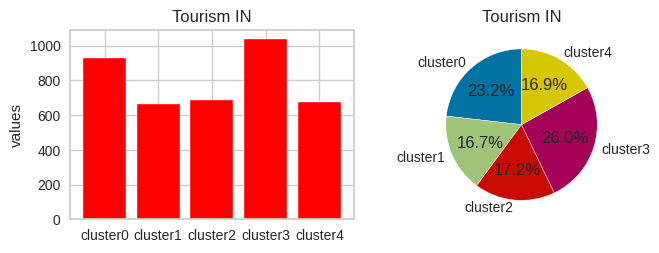

In [165]:
TourismInbound =df_hp_copy.iloc[15]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,TourismInbound, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("Tourism IN")

axes[1].pie(TourismInbound, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("Tourism IN")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

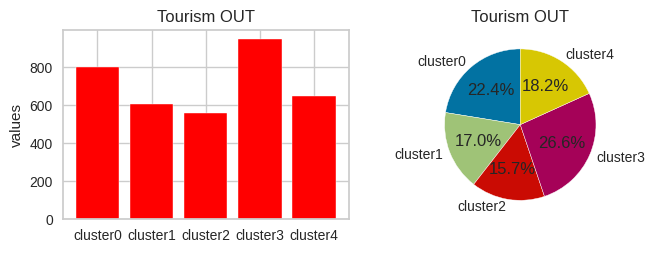

In [166]:
TourismOutbound =df_hp_copy.iloc[16]

fig,axes=plt.subplots(nrows=1,ncols=2,figsize=(12,5))

axes[0].bar(df_hp_copy.columns,TourismOutbound, color='red')
axes[0].set_ylabel('values')
axes[0].set_title("Tourism OUT")

axes[1].pie(TourismOutbound, labels=df_hp_copy.columns, autopct='%1.1f%%', startangle=90)
axes[1].set_title("Tourism OUT")


plt.tight_layout(pad=2,h_pad=0.3,rect=(0.2,0.2,0.8,0.8))

In [167]:
import numpy as np
unique_labels,counts=np.unique(kmeans.labels_,return_counts=True)
cluster_sizes=dict(zip(unique_labels,counts))
cluster_sizes

{0: 488, 1: 549, 2: 596, 3: 563, 4: 508}

In [168]:
from sklearn.metrics import silhouette_samples,silhouette_score

In [169]:
k_silhouette_score_average=silhouette_score(data_tsne_2,kmeans.labels_)

In [170]:
k_silhouette_score_average

0.4065541

Hierarchical

In [171]:
from sklearn.cluster import AgglomerativeClustering #for h.clustering
import scipy.cluster.hierarchy as sch #for_dendrogram
import matplotlib.pyplot as plt

In [172]:
!pip install matplotlib-venn

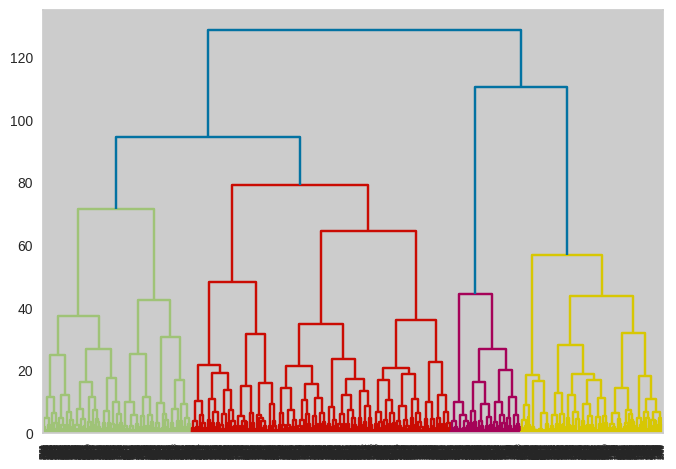

In [173]:
#create dendogram
#import scipy.cluster.hierarchy as sch
!pip install matplotlib
dendrogram=sch.dendrogram(sch.linkage(data_tsne_2,method='complete'))

In [174]:
#create clusters
#from sklearn.cluster import AgglomerativeClustering
model_hc=AgglomerativeClustering(n_clusters=4,affinity='euclidean',linkage='complete')
model_hc.fit(data_tsne_2)

AgglomerativeClustering(affinity='euclidean', linkage='complete', n_clusters=4)

In [175]:
pred=model_hc.fit_predict(data_tsne_2)
pred

array([3, 0, 0, ..., 0, 3, 1])

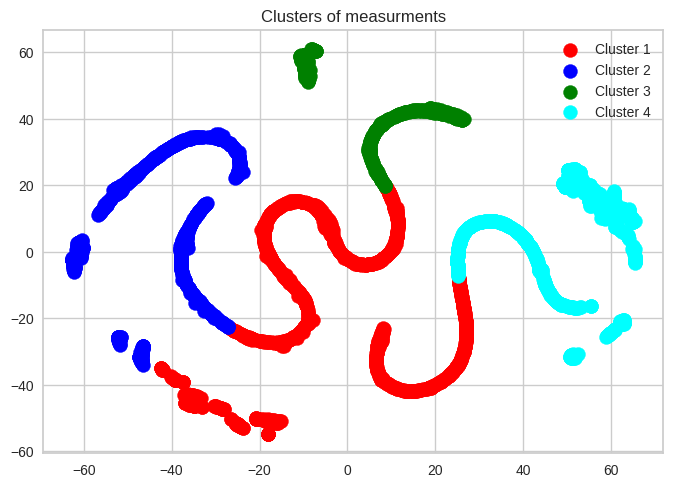

In [176]:
plt.scatter(data_tsne_2[pred == 0, 0], data_tsne_2[pred == 0, 1], s = 100, c = 'red', label = 'Cluster 1')
plt.scatter(data_tsne_2[pred == 1, 0], data_tsne_2[pred == 1, 1], s = 100, c = 'blue', label = 'Cluster 2')
plt.scatter(data_tsne_2[pred == 2, 0], data_tsne_2[pred == 2, 1], s = 100, c = 'green', label = 'Cluster 3')
plt.scatter(data_tsne_2[pred == 3, 0], data_tsne_2[pred == 3, 1], s = 100, c = 'cyan', label = 'Cluster 4')
plt.title('Clusters of measurments')
plt.legend()
plt.show()


In [177]:
hc_silhouette_score_average=silhouette_score(data_tsne_2,pred)
hc_silhouette_score_average

0.35184652

Gaussian Mixture

In [178]:
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(n_components=4)
gmm.fit(data_tsne_2)

GaussianMixture(n_components=4)

In [179]:
gmm_pred=gmm.predict(data_tsne_2)
gmm_pred

array([0, 3, 2, ..., 3, 0, 3])

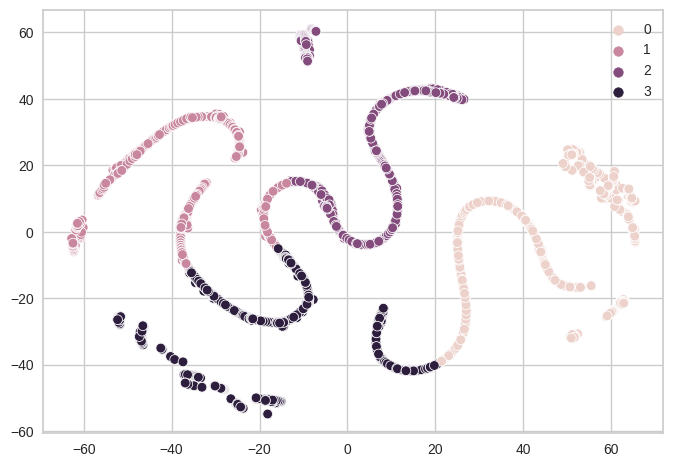

In [180]:
sns.scatterplot(x=data_tsne_2[:, 0],y= data_tsne_2[:, 1], hue=gmm_pred)
plt.show()

In [181]:
gmm_silhouette_score_average=silhouette_score(data_tsne_2,gmm_pred)
gmm_silhouette_score_average

0.40775326

In [182]:
mod={"Model":pd.Series(["KMEANS","HIERARCHICAL","GAUSSIAN"]),"silhouette_score_average":pd.Series([k_silhouette_score_average,hc_silhouette_score_average,gmm_silhouette_score_average])}
table_mod=pd.DataFrame(mod)
table_mod.sort_values(["silhouette_score_average"])

,Model,silhouette_score_average
1,HIERARCHICAL,0.351847
0,KMEANS,0.406554
2,GAUSSIAN,0.407753


In [183]:
import pickle

In [184]:
with open('model_pickle','wb')as f:
  pickle.dump(df,f)

In [185]:
with open('model_pickle','rb')as f:
  mp = pickle.load(f)

In [186]:
mp

,BirthRate,BusinessTaxRate,CO2Emissions,DaystoStartBusiness,EnergyUsage,GDP,HealthExpGDP,HealthExpCapita,InfantMortalityRate,InternetUsage,LifeExpectancyFemale,LifeExpectancyMale,MobilePhoneUsage,PopulationTotal,PopulationUrban,TourismInbound,TourismOutbound,k_clusterid
0,0.020,447,87931.0,26.000,26998.000,1696,0.035,58,0.0340,0.0,71.0,67.0,0.0,3.171945e+07,0.599,185,245,3
1,0.050,447,9542.0,26.000,7499.000,1016,0.034,20,0.1075,0.0,47.0,44.0,0.0,1.392493e+07,0.324,110,206,4
2,0.043,447,1617.0,26.000,1983.000,498,0.043,13,0.0900,0.0,57.0,53.0,0.0,6.949366e+06,0.383,161,115,4
3,0.027,447,4276.0,26.000,1836.000,816,0.047,147,0.0540,0.0,52.0,49.0,0.1,1.755375e+06,0.532,281,260,2
4,0.046,447,1041.0,26.000,14338.000,529,0.051,10,0.0960,0.0,52.0,49.0,0.0,1.160794e+07,0.178,95,89,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2699,0.020,447,8529.0,26.000,14338.000,2494,0.061,626,0.0200,0.1,75.0,69.0,0.5,3.242700e+04,0.911,1650,1457,0
2700,0.013,241,8529.0,5.000,46913.625,2493,0.118,626,0.0060,0.8,81.0,76.0,1.0,4.903473e+07,0.811,1649,1456,3
2701,0.015,200,8529.0,7.000,14338.000,1670,0.089,626,0.0100,0.5,80.0,74.0,1.5,3.395253e+06,0.948,927,683,1
2702,0.020,346,8529.0,55.625,14338.000,2218,0.046,478,0.0130,0.5,78.0,72.0,1.0,2.995478e+07,0.889,644,938,3


In [187]:
pip install streamlit

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 35.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 17.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 24.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.8 MB/s eta 0:00:00
  Attempting uninstall: importlib-metadata
    Found existing installation: importlib-metadata 7.0.0
    Uninstalling importlib-metadata-7.0.0:
      Successfully uninstalled importlib-metadata-7.0.0


In [253]:
%%writefile app.py
import streamlit as st
import pickle
import pandas as pd
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import warnings
warnings.filterwarnings("ignore")
from sklearn.metrics import silhouette_samples,silhouette_score
import plotly.express as px
import numpy as np

# Load the pickle file
with open("model_pickle", "rb") as f:
    mp = pickle.load(f)
st.title("Global Development Measurement")
st.subheader("EDA")
st.write("mp data:", mp.dtypes)
st.write("mp shape:", mp.shape)
st.write("mp columns:", mp.columns)
st.write("Descriptive statistics:", mp.describe())
st.write("Correlation:",mp.corr())
import matplotlib.pyplot as plt
import seaborn as sns

#heatmap

st.subheader("Heatmap")
hm=sns.heatmap(mp.corr(),cmap="magma",annot=True)
st.pyplot(hm.figure)


tsne_result = TSNE(n_components=2).fit_transform(mp)
st.write("tsne_result:", tsne_result)

fig=plt.figure(figsize=(15,6))
sns.scatterplot(x=tsne_result[:,0],y=tsne_result[:,1],color='red')
#plt.title('TSNE before Clustering',fontdict={'color':'red'})
fig.savefig('TSNE-2D.jpg')
plt.show()


kmeans = KMeans(n_clusters=5)
clusters = kmeans.fit_predict(tsne_result)

# Calculate silhouette score
silhouette_avg = silhouette_score(tsne_result, clusters)

# Visualize with Streamlit
st.title("t-SNE Clustering Visualization")

# Scatter plot for t-SNE
st.subheader("t-SNE Plot")
tsne_df = pd.DataFrame(tsne_result, columns=['tsne1', 'tsne2'])
tsne_df['cluster'] = clusters
fig_tsne=plt.scatter(tsne_result[:,0],tsne_result[:,1])

#fig_tsne = sns.scatterplot(x='tsne1', y='tsne2', hue='cluster', data=tsne_df)
st.pyplot(fig_tsne.figure)

# Cluster distribution
st.subheader("Cluster Distribution")
cluster_distribution = pd.Series(clusters).value_counts().sort_index()
st.bar_chart(cluster_distribution)

#Cluster Visualization
st.subheader("Cluster Visualization")
fig_c=sns.scatterplot(x='tsne1', y='tsne2', hue='cluster', data=tsne_df)
st.pyplot(fig_c.figure)

# Silhouette score
st.subheader("Silhouette Score")
st.write(f"The average silhouette score is: {silhouette_avg:.4f}")

Overwriting app.py


In [254]:
!npm install localtunnel

npm WARN saveError ENOENT: no such file or directory, open '/content/package.json'
npm WARN enoent ENOENT: no such file or directory, open '/content/package.json'
npm WARN content No description
npm WARN content No repository field.
npm WARN content No README data
npm WARN content No license field.

+ localtunnel@2.0.2
updated 1 package and audited 36 packages in 0.45s

3 packages are looking for funding
  run `npm fund` for details

found 2 moderate severity vulnerabilities
  run `npm audit fix` to fix them, or `npm audit` for details


In [255]:
!streamlit run app.py &>/content/logs.txt &

In [256]:
!npx localtunnel --port 8501  & curl ipv4.icanhazip.com

35.245.152.24
npx: installed 22 in 2.008s
your url is: https://ninety-humans-type.loca.lt
